# Diabetes Prediction Challenge

The dataset for this competition (both train and test) was generated from a deep learning model trained on the Diabetes Health Indicators Dataset. Feature distributions are close to, but not exactly the same, as the original. Feel free to use the original dataset as part of this competition, both to explore differences as well as to see whether incorporating the original in training improves model performance. diagnosed_diabetes is the target, and for the testing data, you should predict the probability of diagnosed_diabetes

# IMPORT LIBS

In [115]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import math

# from IPython.core.interactiveshell import InteractiveShell
# InteractiveShell.ast_node_interactivity = "all"
# # Set options to display all rows, columns, and prevent wrapping
# pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
# pd.set_option('display.width', None) # CRITICAL for preventing wrapping

# IMPORT DATA SET

In [116]:
df_train = pd.read_csv("../data/raw/train.csv")
df_test = pd.read_csv("../data/raw/test.csv")

In [117]:
# Check Top 5 Train
df_train.head()

,id,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,bmi,waist_to_hip_ratio,systolic_bp,diastolic_bp,heart_rate,cholesterol_total,hdl_cholesterol,ldl_cholesterol,triglycerides,gender,ethnicity,education_level,income_level,smoking_status,employment_status,family_history_diabetes,hypertension_history,cardiovascular_history,diagnosed_diabetes
0,0,31,1,45,7.7,6.8,6.1,33.4,0.93,112,70,62,199,58,114,102,Female,Hispanic,Highschool,Lower-Middle,Current,Employed,0,0,0,1.0
1,1,50,2,73,5.7,6.5,5.8,23.8,0.83,120,77,71,199,50,121,124,Female,White,Highschool,Upper-Middle,Never,Employed,0,0,0,1.0
2,2,32,3,158,8.5,7.4,9.1,24.1,0.83,95,89,73,188,59,114,108,Male,Hispanic,Highschool,Lower-Middle,Never,Retired,0,0,0,0.0
3,3,54,3,77,4.6,7.0,9.2,26.6,0.83,121,69,74,182,54,85,123,Female,White,Highschool,Lower-Middle,Current,Employed,0,1,0,1.0
4,4,54,1,55,5.7,6.2,5.1,28.8,0.90,108,60,85,206,49,131,124,Male,White,Highschool,Upper-Middle,Never,Retired,0,1,0,1.0


In [118]:
# Check Top 5 Test
df_test.head()

,id,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,bmi,waist_to_hip_ratio,systolic_bp,diastolic_bp,heart_rate,cholesterol_total,hdl_cholesterol,ldl_cholesterol,triglycerides,gender,ethnicity,education_level,income_level,smoking_status,employment_status,family_history_diabetes,hypertension_history,cardiovascular_history
0,700000,45,4,100,4.3,6.8,6.2,25.5,0.84,123,70,64,209,55,135,111,Female,White,Highschool,Middle,Former,Employed,0,0,0
1,700001,35,1,87,3.5,4.6,9.0,28.6,0.88,120,74,59,159,47,83,145,Female,White,Highschool,Middle,Never,Unemployed,0,0,0
2,700002,45,1,61,7.6,6.8,7.0,28.5,0.94,112,71,75,173,43,99,184,Male,White,Highschool,Low,Never,Employed,0,0,0
3,700003,55,2,81,7.3,7.3,5.0,26.9,0.91,114,81,61,203,59,116,128,Male,White,Graduate,Middle,Former,Employed,0,0,0
4,700004,77,2,29,7.3,7.6,8.5,22.0,0.83,131,78,79,177,59,87,133,Male,White,Graduate,Low,Current,Unemployed,0,0,0


# EDA

In [119]:
# Check nan values
print(df_train.isna().sum())
print(df_test.isna().sum())

id                                    0
age                                   0
alcohol_consumption_per_week          0
physical_activity_minutes_per_week    0
diet_score                            0
sleep_hours_per_day                   0
screen_time_hours_per_day             0
bmi                                   0
waist_to_hip_ratio                    0
systolic_bp                           0
diastolic_bp                          0
heart_rate                            0
cholesterol_total                     0
hdl_cholesterol                       0
ldl_cholesterol                       0
triglycerides                         0
gender                                0
ethnicity                             0
education_level                       0
income_level                          0
smoking_status                        0
employment_status                     0
family_history_diabetes               0
hypertension_history                  0
cardiovascular_history                0


In [120]:
# Check Duplicates
print(df_train.duplicated().sum())
print(df_test.duplicated().sum())

0
0


In [121]:
# Dataset info
print(df_train.info())
print(df_test.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700000 entries, 0 to 699999
Data columns (total 26 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   id                                  700000 non-null  int64  
 1   age                                 700000 non-null  int64  
 2   alcohol_consumption_per_week        700000 non-null  int64  
 3   physical_activity_minutes_per_week  700000 non-null  int64  
 4   diet_score                          700000 non-null  float64
 5   sleep_hours_per_day                 700000 non-null  float64
 6   screen_time_hours_per_day           700000 non-null  float64
 7   bmi                                 700000 non-null  float64
 8   waist_to_hip_ratio                  700000 non-null  float64
 9   systolic_bp                         700000 non-null  int64  
 10  diastolic_bp                        700000 non-null  int64  
 11  heart_rate                

In [122]:
# Dataset Description
df_train.describe()

,id,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,bmi,waist_to_hip_ratio,systolic_bp,diastolic_bp,heart_rate,cholesterol_total,hdl_cholesterol,ldl_cholesterol,triglycerides,family_history_diabetes,hypertension_history,cardiovascular_history,diagnosed_diabetes
count,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000,700000.000000
mean,349999.500000,50.359734,2.072411,80.230803,5.963695,7.002200,6.012733,25.874684,0.858766,116.294193,75.440924,70.167749,186.818801,53.823214,102.905854,123.081850,0.149401,0.181990,0.030324,0.623296
std,202072.738554,11.655520,1.048189,51.195071,1.463336,0.901907,2.022707,2.860705,0.037980,11.010390,6.825775,6.938722,16.730832,8.266545,19.022416,24.739397,0.356484,0.385837,0.171478,0.484560
min,0.000000,19.000000,1.000000,1.000000,0.100000,3.100000,0.600000,15.100000,0.680000,91.000000,51.000000,42.000000,117.000000,21.000000,51.000000,31.000000,0.000000,0.000000,0.000000,0.000000
25%,174999.750000,42.000000,1.000000,49.000000,5.000000,6.400000,4.600000,23.900000,0.830000,108.000000,71.000000,65.000000,175.000000,48.000000,89.000000,106.000000,0.000000,0.000000,0.000000,0.000000
50%,349999.500000,50.000000,2.000000,71.000000,6.000000,7.000000,6.000000,25.900000,0.860000,116.000000,75.000000,70.000000,187.000000,54.000000,103.000000,123.000000,0.000000,0.000000,0.000000,1.000000
75%,524999.250000,58.000000,3.000000,96.000000,7.000000,7.600000,7.400000,27.800000,0.880000,124.000000,80.000000,75.000000,199.000000,59.000000,116.000000,139.000000,0.000000,0.000000,0.000000,1.000000
max,699999.000000,89.000000,9.000000,747.000000,9.900000,9.900000,16.500000,38.400000,1.050000,163.000000,104.000000,101.000000,289.000000,90.000000,205.000000,290.000000,1.000000,1.000000,1.000000,1.000000


Instance of a potential data Anomaly detechted in physical_activity_minutes_per_week, ldl_cholesterol, triglycerides

In [123]:
# Test Description
df_test.describe()

,id,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,bmi,waist_to_hip_ratio,systolic_bp,diastolic_bp,heart_rate,cholesterol_total,hdl_cholesterol,ldl_cholesterol,triglycerides,family_history_diabetes,hypertension_history,cardiovascular_history
count,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000,300000.000000
mean,849999.500000,50.432397,2.089693,92.349087,5.945838,6.997795,6.011278,25.881906,0.859007,116.374117,75.396013,70.048350,187.308620,53.813557,103.416083,123.538480,0.152920,0.184410,0.033110
std,86602.684716,11.938741,1.066214,62.187399,1.481068,0.914693,2.060472,2.894289,0.038523,11.252146,6.950340,7.090543,18.413053,8.398126,20.571855,28.965441,0.359911,0.387819,0.178924
min,700000.000000,19.000000,1.000000,1.000000,0.100000,3.100000,0.600000,15.100000,0.690000,91.000000,51.000000,42.000000,107.000000,22.000000,51.000000,31.000000,0.000000,0.000000,0.000000
25%,774999.750000,42.000000,1.000000,51.000000,5.000000,6.400000,4.600000,23.900000,0.830000,108.000000,71.000000,65.000000,174.000000,48.000000,89.000000,104.000000,0.000000,0.000000,0.000000
50%,849999.500000,50.000000,2.000000,77.000000,6.000000,7.000000,6.000000,25.900000,0.860000,116.000000,75.000000,70.000000,187.000000,54.000000,103.000000,123.000000,0.000000,0.000000,0.000000
75%,924999.250000,59.000000,3.000000,115.000000,7.000000,7.600000,7.400000,27.800000,0.890000,124.000000,80.000000,75.000000,200.000000,60.000000,117.000000,142.000000,0.000000,0.000000,0.000000
max,999999.000000,89.000000,9.000000,748.000000,9.900000,9.900000,15.900000,38.300000,1.050000,170.000000,104.000000,101.000000,285.000000,91.000000,226.000000,290.000000,1.000000,1.000000,1.000000


### Insight
1. Significant Distribution Shift in Physical Activity
There is a notable inconsistency between the training and testing populations regarding physical activity.

Observation: The average physical_activity_minutes_per_week is 15.1% higher in the Test set (92.3 mins) compared to the Train set (80.2 mins).

Implication: This suggests a "covariate shift." If your machine learning model relies heavily on physical activity to predict diabetes, it might behave unexpectedly on the test data because the test population is, on average, more active than the population the model learned from.

2. Target Variable Imbalance (Diabetes Prevalence)
The training dataset is slightly skewed towards individuals diagnosed with diabetes.

Observation: The mean of diagnosed_diabetes is 0.623, meaning 62.3% of the individuals in the training set have diabetes.

Implication: This is not a typical "rare disease" dataset where positives are <1%. In fact, the positive class is the majority. You likely do not need aggressive oversampling techniques (like SMOTE), but you should ensure your evaluation metrics (like Precision/Recall) account for this majority class to avoid the "accuracy paradox."

3. Population Health Profile
The "average" individual in this dataset fits a specific profile that borders on unhealthy in several metrics:

Age: Middle-aged (Mean ~50 years).

BMI: Mean BMI is 25.9, which falls into the Overweight category (25.0 – 29.9).

Blood Pressure: Averages are healthy (116/75 mmHg), well below the hypertension threshold (130/80 or 140/90).

Lifestyle:

Screen Time: High average of ~6 hours per day.

Diet Score: Moderate average of ~6.0/10.

4. Data Quality & Consistency
Stable Features: Apart from physical activity, most other physiological features (Age, BMI, Blood Pressure, Cholesterol) are extremely consistent between Train and Test sets (differences <1%), indicating a generally good random split.

Rare Conditions: cardiovascular_history is rare (approx. 3% of population), but shows a slight variance between sets (3.0% in Train vs. 3.3% in Test, a ~9% relative difference).

In [124]:
df_train.head()

,id,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,bmi,waist_to_hip_ratio,systolic_bp,diastolic_bp,heart_rate,cholesterol_total,hdl_cholesterol,ldl_cholesterol,triglycerides,gender,ethnicity,education_level,income_level,smoking_status,employment_status,family_history_diabetes,hypertension_history,cardiovascular_history,diagnosed_diabetes
0,0,31,1,45,7.7,6.8,6.1,33.4,0.93,112,70,62,199,58,114,102,Female,Hispanic,Highschool,Lower-Middle,Current,Employed,0,0,0,1.0
1,1,50,2,73,5.7,6.5,5.8,23.8,0.83,120,77,71,199,50,121,124,Female,White,Highschool,Upper-Middle,Never,Employed,0,0,0,1.0
2,2,32,3,158,8.5,7.4,9.1,24.1,0.83,95,89,73,188,59,114,108,Male,Hispanic,Highschool,Lower-Middle,Never,Retired,0,0,0,0.0
3,3,54,3,77,4.6,7.0,9.2,26.6,0.83,121,69,74,182,54,85,123,Female,White,Highschool,Lower-Middle,Current,Employed,0,1,0,1.0
4,4,54,1,55,5.7,6.2,5.1,28.8,0.90,108,60,85,206,49,131,124,Male,White,Highschool,Upper-Middle,Never,Retired,0,1,0,1.0


In [125]:
# Seperate num and cat cols

# Num Cols
num_cols = df_train.select_dtypes(include=["int64", "float64"]).columns
# Cat Cols
cat_cols = df_train.select_dtypes(include=["object", "category"]).columns

# Binary Cols
bin_col = ["family_history_diabetes", "hypertension_history", "cardiovascular_history"]

# Target Col
target_col = "diagnosed_diabetes"

# Drop target Col from num col
if target_col in num_cols:
    num_cols = num_cols.drop(target_col)

# Id
id = "id"

# Drop Id col from num col
if id in num_cols:
    num_cols = num_cols.drop(id)

# Remove Binary Cols
existing_bin_cols = [c for c in bin_col if c in num_cols]
num_cols = num_cols.drop(existing_bin_cols)

col_df = [num_cols, cat_cols]
print(col_df)

[Index(['age', 'alcohol_consumption_per_week',
       'physical_activity_minutes_per_week', 'diet_score',
       'sleep_hours_per_day', 'screen_time_hours_per_day', 'bmi',
       'waist_to_hip_ratio', 'systolic_bp', 'diastolic_bp', 'heart_rate',
       'cholesterol_total', 'hdl_cholesterol', 'ldl_cholesterol',
       'triglycerides'],
      dtype='object'), Index(['gender', 'ethnicity', 'education_level', 'income_level',
       'smoking_status', 'employment_status'],
      dtype='object')]


In [126]:
print(num_cols)
print(cat_cols)

Index(['age', 'alcohol_consumption_per_week',
       'physical_activity_minutes_per_week', 'diet_score',
       'sleep_hours_per_day', 'screen_time_hours_per_day', 'bmi',
       'waist_to_hip_ratio', 'systolic_bp', 'diastolic_bp', 'heart_rate',
       'cholesterol_total', 'hdl_cholesterol', 'ldl_cholesterol',
       'triglycerides'],
      dtype='object')
Index(['gender', 'ethnicity', 'education_level', 'income_level',
       'smoking_status', 'employment_status'],
      dtype='object')


# DATA VISUALISATION

## NUMERICAL VARIABLES

### Histogram

In [127]:
def plot_histograms(
    df,
    columns,
    n_cols=3,
    figsize_width=15,
    row_height=5,
    bins=30,
    dropna=True
):
   
    n_rows = math.ceil(len(columns) / n_cols)
    figsize_height = n_rows * row_height

    # Create figure and axes once
    fig, axes = plt.subplots(
        nrows=n_rows,
        ncols=n_cols,
        figsize=(figsize_width, figsize_height),
        constrained_layout=True
    )

    # Flatten axes for easy indexing
    axes = axes.flatten() if n_rows > 1 else [axes]

    # Plot histograms
    for i, col in enumerate(columns):
        ax = axes[i]
        data = df[col].dropna() if dropna else df[col]

        ax.hist(data, bins=bins)
        ax.set_title(f"Histogram of {col}")
        ax.set_xlabel("Value")
        ax.set_ylabel("Frequency")

    # Remove unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.show()

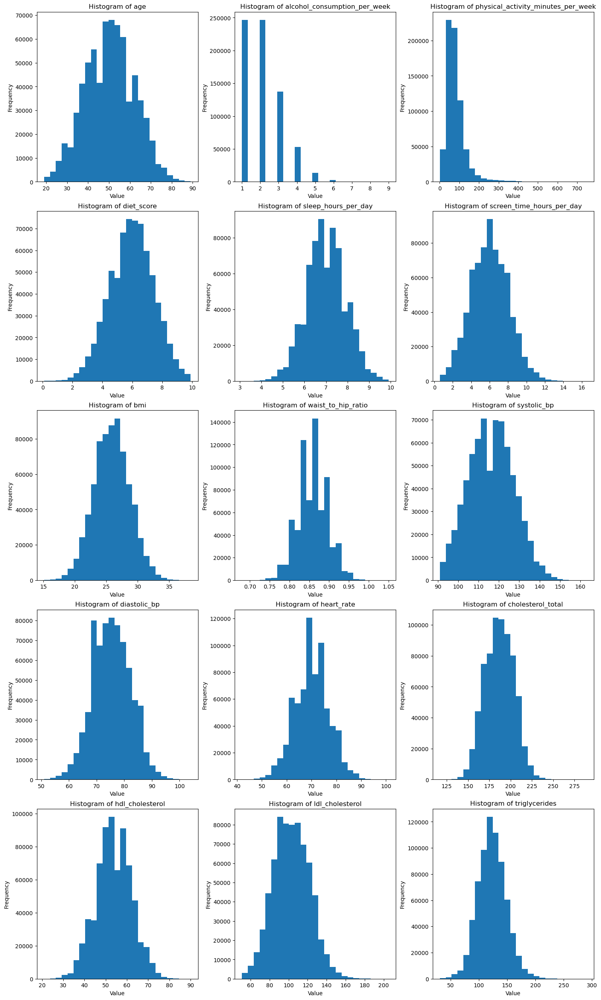

In [128]:
plot_histograms(
    df=df_train,
    columns=num_cols,
    n_cols=3,
    bins=25
)

## 1. Lifestyle & Behavioral Insights

The most striking insights come from the **behavioral variables**, which show distinct skewing compared to the biological ones.

### Sedentary Lifestyle (Physical Activity)
- The `physical_activity_minutes_per_week` histogram is **strongly right-skewed**.
- The vast majority of the population falls into the **lowest bin (0–100 minutes)**.
- Very few individuals engage in high levels of physical activity.
- This suggests a **largely sedentary population**.

### Alcohol Consumption
- Alcohol consumption is also **right-skewed**.
- The highest frequency appears in the **0–2 drinks** range.
- This indicates that most individuals consume **little to no alcohol**, with a long tail of moderate-to-heavy drinkers.

### Screen Time vs. Sleep
- **Screen Time (`screen_time_hours_per_day`)**
  - Peaks around **6 hours per day**.
  - A significant portion of the population reaches **8–10 hours**, indicating high screen exposure.
- **Sleep (`sleep_hours_per_day`)**
  - Follows a near-perfect **normal distribution**.
  - Centered tightly around **7 hours**, which aligns with the recommended average for adults.

### Diet
- The `diet_score` (assumed scale of 1–10) is **approximately normal**.
- Slightly skewed toward the higher end, peaking around **6–7**.
- This suggests the population generally attempts a **moderately healthy diet**.

---

## 2. Physical Health & Biometrics

Unlike lifestyle metrics, most **biological markers follow a Normal Distribution (Bell Curve)**, which is expected in population-level health data.

### Weight & BMI
- **BMI**
  - Centers roughly between **25 and 28**.
  - Since a BMI of **25–29.9** is classified as *overweight*, the average individual is **slightly overweight**.
  - This aligns with the observed **low physical activity levels**.
- **Waist-to-Hip Ratio**
  - Centers around **0.90**.
  - This is on the **higher end of the metabolic risk spectrum**  
    (typically >0.90 for men and >0.85 for women).

### Cardiovascular Health
- **Blood Pressure**
  - `Systolic_bp` peaks around **120 mmHg**.
  - `Diastolic_bp` peaks around **70–80 mmHg**.
  - These values reflect **textbook healthy averages**.
- **Heart Rate**
  - Centers around **70 bpm**, a normal resting heart rate.

### Cholesterol
- **Total Cholesterol**
  - Centers around **180–190 mg/dL**, which is considered **healthy/desirable** (below 200).
- **LDL Cholesterol (Bad Cholesterol)**
  - Centers around **100–120 mg/dL**.
  - This falls in the **near-optimal to borderline-high** range.

---

## 3. Demographics (Age)

- The age distribution spans approximately **20 to 90 years**.
- The histogram is **fairly symmetric** overall.
- There is a noticeable plateau between **45–60 years**.
- This indicates a population **dominated by middle-aged adults**, rather than very young or very old individuals.


### Boxplot

In [129]:
def plot_boxplots(
    df,
    columns,
    n_cols=3,
    figsize_width=15,
    row_height=5,
    dropna=True
):


    n_rows = math.ceil(len(columns) / n_cols)
    figsize_height = n_rows * row_height

    # Create figure and axes once
    fig, axes = plt.subplots(
        nrows=n_rows,
        ncols=n_cols,
        figsize=(figsize_width, figsize_height),
        constrained_layout=True
    )

    # Flatten axes for easy indexing
    axes = axes.flatten() if n_rows > 1 else [axes]

    # Plot boxplots
    for i, col in enumerate(columns):
        ax = axes[i]
        data = df[col].dropna() if dropna else df[col]

        sns.boxplot(y=data, ax=ax)
        ax.set_title(f"Box Plot of {col}")
        ax.set_xlabel("")
        ax.set_ylabel("Value")

    # Remove unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.show()

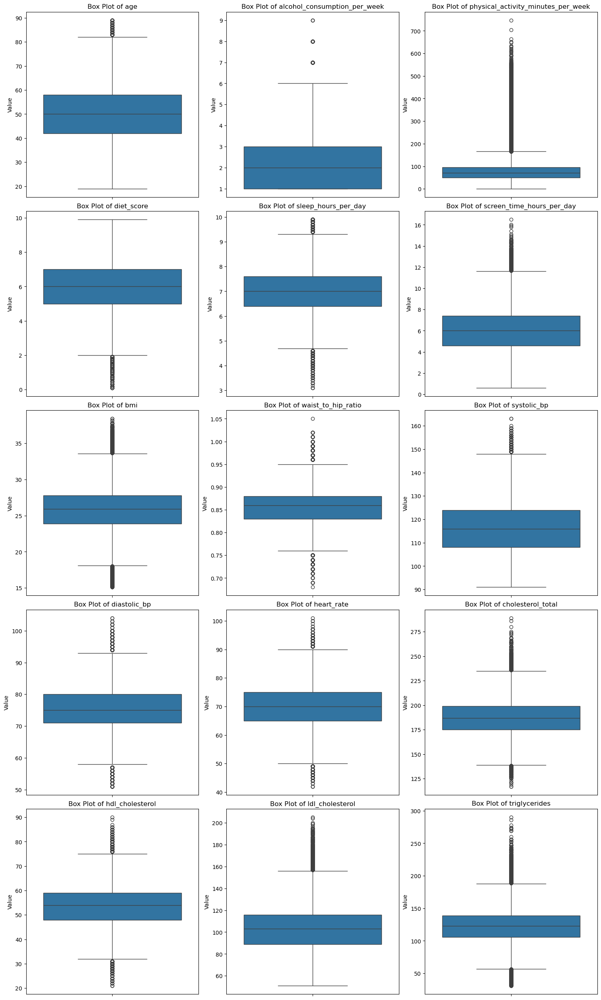

In [130]:
plot_boxplots(
    df=df_train,
    columns=num_cols,
    n_cols=3
)

## Insights

### 1. Extreme Outliers in Physical Activity
**The Insight:**  
The `physical_activity_minutes_per_week` box plot is the most dramatic. The *box* (representing the middle 50% of the population) is extremely compressed at the bottom of the chart.

**Interpretation:**  
This confirms that the vast majority of the population is **sedentary**. However, the stream of outliers extending upward reveals a long tail of **“super-users” or athletes**, with some individuals recording **600+ minutes** of weekly activity.

**Data Science Note:**  
These extreme values can significantly skew statistics such as the mean and negatively impact machine learning models. Consider using a **RobustScaler** or applying a **log transformation** to this feature.

---

### 2. Health Risk “Danger Zones”
The biometric box plots show that while the *average* individual appears healthy, there is a consistent **high-risk subgroup**.

**Blood Pressure (Systolic & Diastolic):**
- Median values are stable around **120/80 mmHg**.
- Outliers appear almost exclusively on the **upper end**.
- Some individuals exhibit **Systolic BP > 160** and **Diastolic BP > 100**.

**Interpretation:**  
This pattern suggests a **specific hypertensive subpopulation**, rather than a general upward shift across the entire population.

**BMI:**
- Outliers skew strongly upward.
- There are virtually no underweight outliers.
- Many observations fall in the **obese range (BMI > 35)**.

---

### 3. Discrete Data Artifacts

**Alcohol Consumption:**
- Outliers appear as **perfectly spaced horizontal lines** (e.g., 6, 7, 8, 9).
- This confirms the data is **discrete (integer-based)**, likely collected via a survey question such as *“How many drinks per week?”* rather than continuous measurement.



---

### 4. Tight Consistency in Lifestyle

**Sleep & Screen Time:**
- The box plots for `sleep_hours` and `screen_time` are relatively **tall, symmetrical**, and show fewer extreme outliers compared to physical activity.

**Interpretation:**  
Sleep and screen usage behaviors are **highly consistent** across the population, with most individuals clustering reliably within the **6–8 hour range**.

---

### Summary Table

| Feature Category          | Distribution Characteristic     | Insight                                                              |
|---------------------------|----------------------------------|----------------------------------------------------------------------|
| Physical Activity         | Compressed box, extreme outliers | Majority sedentary; small group of very high performers              |
| Biometrics (BP, BMI)      | Normal box, upper outliers       | Health risks concentrated in a specific high-risk subgroup           |
| Lifestyle (Sleep/Screen)  | Symmetrical, moderate spread     | High uniformity in population habits                                 |
| Medical History (Binary)  | Collapsed box                   | Rare-event data with strong class imbalance                          |


Applying a log transformation as a corrective step after outlier removal proved ineffective.

In [145]:
def safe_log_transform(df, cols):
    df_transformed = df.copy()
    
    for col in cols:
        min_val = df_transformed[col].min()
        shift = 1 - min_val if min_val <= 0 else 0  # shift to make min > 0
        df_transformed[col] = np.log(df_transformed[col] + shift)
    
    return df_transformed

In [147]:
df_log = pd.DataFrame(df_train, columns=num_cols)
df_log = safe_log_transform(df_test, num_cols)

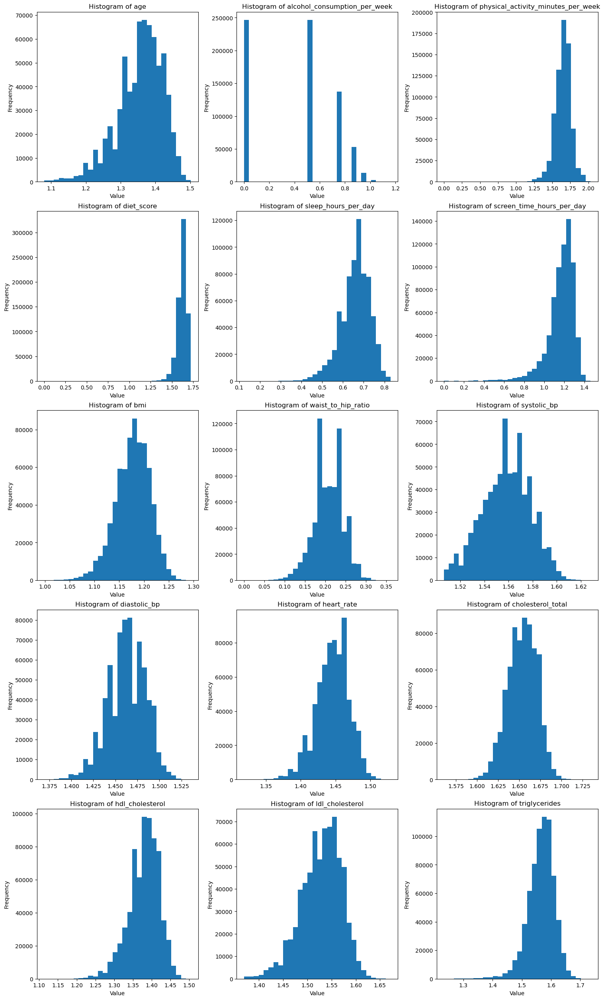

In [148]:
plot_histograms(df_log, num_cols)

### Applying Power Transformation

In [149]:
from sklearn.preprocessing import PowerTransformer

pt = PowerTransformer(method="yeo-johnson", standardize=True)

df_test = pt.fit_transform(df_log[num_cols])

In [150]:
df_test = pd.DataFrame(df_test, columns=num_cols)
df_test.head()

,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,bmi,waist_to_hip_ratio,systolic_bp,diastolic_bp,heart_rate,cholesterol_total,hdl_cholesterol,ldl_cholesterol,triglycerides
0,-1.688915,-1.259214,-0.770187,1.192504,-0.222821,0.089930,2.590493,1.859697,-0.370536,-0.797975,-1.177961,0.734464,0.506552,0.601719,-0.849026
1,-0.015272,0.290383,0.095053,-0.183673,-0.558764,-0.060329,-0.723821,-0.755638,0.356798,0.228931,0.118811,0.734464,-0.465565,0.954937,0.060561
2,-1.600164,0.980196,1.523241,1.736803,0.446699,1.472750,-0.617939,-0.755638,-2.002551,1.985030,0.407748,0.083993,0.627997,0.601719,-0.597156
3,0.328010,0.980196,0.192005,-0.941139,0.000840,1.515413,0.259724,-0.755638,0.446038,-0.944601,0.552253,-0.275672,0.020417,-0.939654,0.020045
4,0.328010,-1.259214,-0.414521,-0.183673,-0.894639,-0.419962,1.023683,1.085520,-0.743534,-2.260321,2.140687,1.142559,-0.586905,1.447868,0.060561


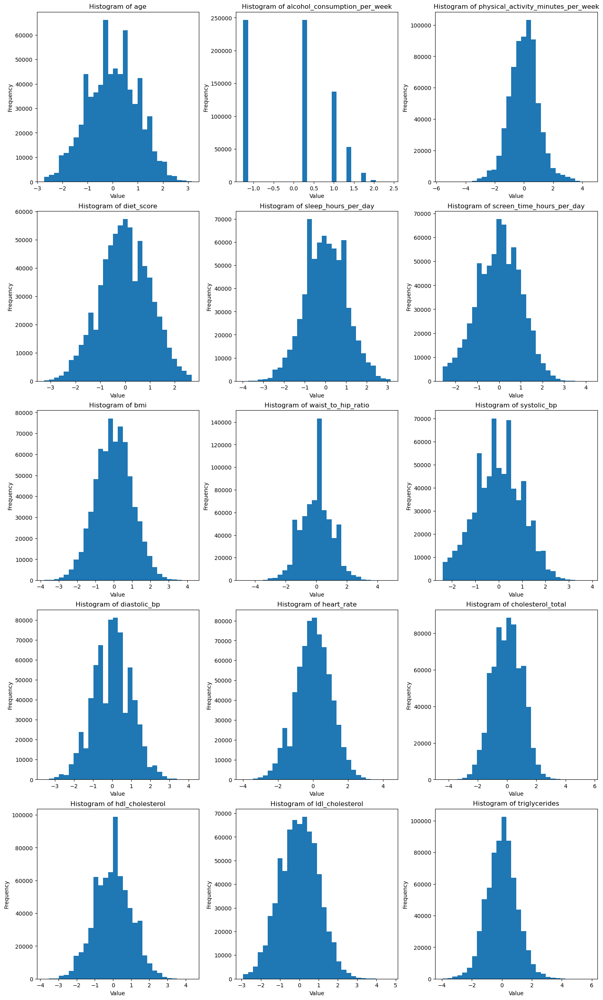

In [151]:
plot_histograms(df_test, num_cols)

In [144]:
def count_extreme_values(df, columns, upper=2, lower=-2):

    results = {}

    for col in columns:
        above_upper = (df[col] > upper).sum()
        below_lower = (df[col] < lower).sum()

        results[col] = {
            f">{upper}": above_upper,
            f"<{lower}": below_lower
        }

    return results


In [136]:
num_cols

Index(['age', 'alcohol_consumption_per_week',
       'physical_activity_minutes_per_week', 'diet_score',
       'sleep_hours_per_day', 'screen_time_hours_per_day', 'bmi',
       'waist_to_hip_ratio', 'systolic_bp', 'diastolic_bp', 'heart_rate',
       'cholesterol_total', 'hdl_cholesterol', 'ldl_cholesterol',
       'triglycerides'],
      dtype='object')

In [138]:
outlier_bounds = {
    "age": (2, -2),
    "alcohol_consumption_per_week": (2, -2),
    "physical_activity_minutes_per_week": (2, -2),
    "diet_score": (2, -2),
    "sleep_hours_per_day": (2, -2),
    "screen_time_hours_per_day": (2, -2),
    "bmi": (2, -2),
    "waist_to_hip_ratio": (2, -2),
    "systolic_bp": (2, -2),
    "diastolic_bp": (2, -2),
    "heart_rate": (2, -2),
    "cholesterol_total": (2, -2),
    "hdl_cholesterol": (2, -2),
    "ldl_cholesterol": (2, -2),
    "triglycerides": (2, -2),
}


In [139]:
def extract_and_remove_outliers(df, bounds):

    outlier_mask = pd.Series(False, index=df.index)

    for col, (upper, lower) in bounds.items():
        if col not in df.columns:
            continue

        if upper is not None:
            outlier_mask |= df[col] > upper

        if lower is not None:
            outlier_mask |= df[col] < lower

    df_outliers = df.loc[outlier_mask].copy()
    df_clean = df.loc[~outlier_mask].copy()

    return df_clean, df_outliers


In [141]:
test_df_clean, test_df_outliers = extract_and_remove_outliers(
    df=df_test,
    bounds=outlier_bounds
)

In [142]:
test_df_clean.shape

(395815, 15)

In [143]:
test_df_outliers.shape

(304185, 15)

Outlier removal led to a substantial reduction in the dataset, suggesting that extreme values are pervasive rather than isolated anomalies. Furthermore, Robust Scaling showed limited effectiveness in reducing the influence of these extremes, as many observations remained pronounced after scaling. As a next step, a log transformation will be applied prior to the power transformation to assess whether this further stabilizes the distribution and mitigates the impact of extreme values.

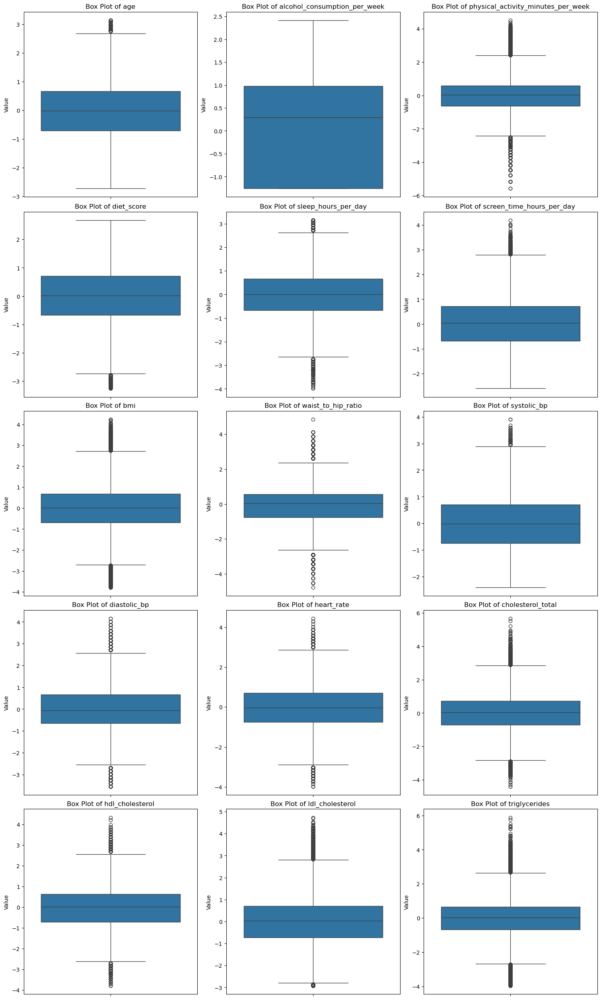

In [152]:
plot_boxplots(df_test, num_cols)

### Power Transformation Improves Distribution, but Outliers Persist

Applying a power transformation (e.g., Yeo–Johnson or Box–Cox) noticeably reduces skew and brings the majority of the data closer to a symmetric distribution. The central bulk of the distribution becomes more regular, making it easier for models to learn from.  

However, extreme outliers remain prominent. While the transformation compresses large values somewhat, these extreme points still lie far from the central range. They may continue to influence models that are sensitive to magnitude, such as linear regression or distance-based algorithms.

**Takeaway:**  
- Power transformations improve overall distribution shape.  
- Outliers may still require additional handling (e.g., robust scaling, capping, or modeling separately) for sensitive models.  


In [153]:
from sklearn.preprocessing import RobustScaler
rb = RobustScaler()
df_test = rb.fit_transform(df_test)

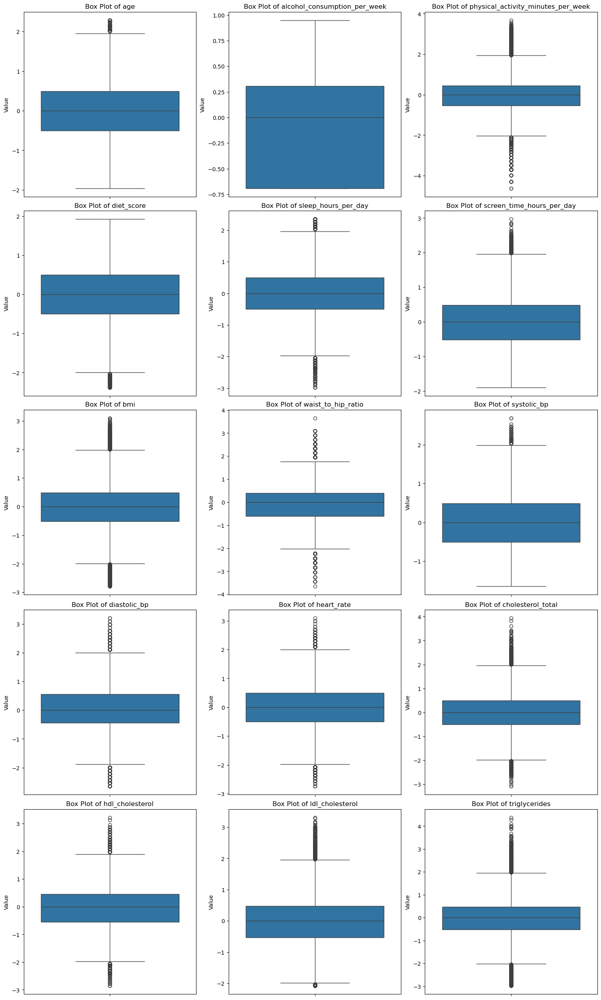

In [154]:
df_test = pd.DataFrame(df_test, columns=num_cols)
plot_boxplots(df_test, num_cols)

### Print Unique Items

In [155]:
# Function Finds Unique Features
def print_unique_features(df, col_name):
    for col in df[col_name]:
        print(f"\nUnique values for column: {col}")
        print(df[col].unique())
print_unique_features(df_train, num_cols)


Unique values for column: age
[31 50 32 54 42 41 51 34 44 47 63 40 57 49 43 70 53 45 59 52 73 61 33 38
 20 56 46 48 62 39 36 21 22 55 30 67 25 60 28 26 65 74 37 68 23 58 84 27
 64 66 35 72 29 79 75 80 71 77 24 78 69 19 82 81 76 83 87 85 86 88 89]

Unique values for column: alcohol_consumption_per_week
[1 2 3 4 5 6 7 8 9]

Unique values for column: physical_activity_minutes_per_week
[ 45  73 158  77  55 100 148 102  44  36 239  58 109 251  57  99  53  54
  94  29  72  46  52 118  82 140  47  59  92  32  28  70  34  83  91  98
 217  84 135  41  43 113  90  37 142 174 144 196   4  42 166  65  85 194
 110  64  48  30  40 130  31  13 141  50 105  78 237  96  74  49  81 337
  14 126  61 101  63 112  39 139 122  89  76  23  25 183  56 117 115  51
  80  95 275 120  69  26  27  60  75  88 111  66 405 311  79  24  86 199
  87  71  67 226 178 103 106  93  68  16  35 131  97  38  62 328 181 104
 376 125 127 137 107 208 202 219 121  17 108  19 150 224  10 163 133  18
 324 129 227 281 155 256  11  

### Bins

In [156]:
# Creating Bins For Data
df = pd.DataFrame()

# AGE
df["age_bin"] = pd.cut(
    df_train["age"],
    bins=[0, 19, 29, 39, 49, 64, np.inf],
    labels=["Teen", "Young Adult", "Adult", "Middle-aged", "Senior", "Elderly"]
)

# ALCOHOL CONSUMPTION
df["alcohol_bin"] = pd.cut(
    df_train["alcohol_consumption_per_week"],
    bins=[-1, 1, 3, 6, np.inf],
    labels=["None/Very Low", "Low", "Moderate", "High"]
)

# PHYSICAL ACTIVITY
df["activity_bin"] = pd.cut(
    df_train["physical_activity_minutes_per_week"],
    bins=[-1, 59, 149, 299, 449, np.inf],
    labels=["Sedentary", "Low", "Moderate", "Active", "Very Active"]
)

# DIET SCORE
df["diet_bin"] = pd.cut(
    df_train["diet_score"],
    bins=[-0.1, 3, 5, 7, 10],
    labels=["Poor", "Fair", "Good", "Excellent"]
)

# SLEEP HOURS
df["sleep_bin"] = pd.cut(
    df_train["sleep_hours_per_day"],
    bins=[0, 5, 6, 8, np.inf],
    labels=["Very Low", "Low", "Optimal", "High"]
)

# SCREEN TIME
df["screen_time_bin"] = pd.cut(
    df_train["screen_time_hours_per_day"],
    bins=[0, 3, 6, 10, np.inf],
    labels=["Low", "Moderate", "High", "Excessive"]
)

# BMI
df["bmi_bin"] = pd.cut(
    df_train["bmi"],
    bins=[0, 18.5, 24.9, 29.9, 34.9, np.inf],
    labels=["Underweight", "Normal", "Overweight", "Obese I", "Obese II+"]
)

# WAIST-TO-HIP RATIO
df["whr_bin"] = pd.cut(
    df_train["waist_to_hip_ratio"],
    bins=[0, 0.85, 0.94, np.inf],
    labels=["Normal", "Elevated", "High Risk"]
)

# SYSTOLIC BP
df["sys_bp_bin"] = pd.cut(
    df_train["systolic_bp"],
    bins=[0, 119, 129, 139, np.inf],
    labels=["Normal", "Elevated", "HTN Stage 1", "HTN Stage 2"]
)

# DIASTOLIC BP
df["dia_bp_bin"] = pd.cut(
    df_train["diastolic_bp"],
    bins=[0, 79, 89, 99, np.inf],
    labels=["Normal", "Elevated", "HTN Stage 1", "HTN Stage 2"]
)

# HEART RATE
df["heart_rate_bin"] = pd.cut(
    df_train["heart_rate"],
    bins=[0, 59, 100, np.inf],
    labels=["Low", "Normal", "High"]
)

# TOTAL CHOLESTEROL
df["chol_total_bin"] = pd.cut(
    df_train["cholesterol_total"],
    bins=[0, 199, 239, np.inf],
    labels=["Desirable", "Borderline", "High"]
)

# HDL
df["hdl_bin"] = pd.cut(
    df_train["hdl_cholesterol"],
    bins=[0, 39, 59, np.inf],
    labels=["Low", "Normal", "Protective"]
)

# LDL
df["ldl_bin"] = pd.cut(
    df_train["ldl_cholesterol"],
    bins=[0, 99, 129, 159, np.inf],
    labels=["Optimal", "Borderline", "High", "Very High"]
)

# TRIGLYCERIDES
df["triglycerides_bin"] = pd.cut(
    df_train["triglycerides"],
    bins=[0, 149, 199, 499, np.inf],
    labels=["Normal", "Borderline", "High", "Very High"]
)

# Quick sanity check
df.filter(like="_bin").head()


,age_bin,alcohol_bin,activity_bin,diet_bin,sleep_bin,screen_time_bin,bmi_bin,whr_bin,sys_bp_bin,dia_bp_bin,heart_rate_bin,chol_total_bin,hdl_bin,ldl_bin,triglycerides_bin
0,Adult,None/Very Low,Sedentary,Excellent,Optimal,High,Obese I,Elevated,Normal,Normal,Normal,Desirable,Normal,Borderline,Normal
1,Senior,Low,Low,Good,Optimal,Moderate,Normal,Normal,Elevated,Normal,Normal,Desirable,Normal,Borderline,Normal
2,Adult,Low,Moderate,Excellent,Optimal,High,Normal,Normal,Normal,Elevated,Normal,Desirable,Normal,Borderline,Normal
3,Senior,Low,Low,Fair,Optimal,High,Overweight,Normal,Elevated,Normal,Normal,Desirable,Normal,Optimal,Normal
4,Senior,None/Very Low,Sedentary,Good,Optimal,Moderate,Overweight,Elevated,Normal,Normal,Normal,Borderline,Normal,High,Normal


### Bar Charts for Selected Numerical Variables

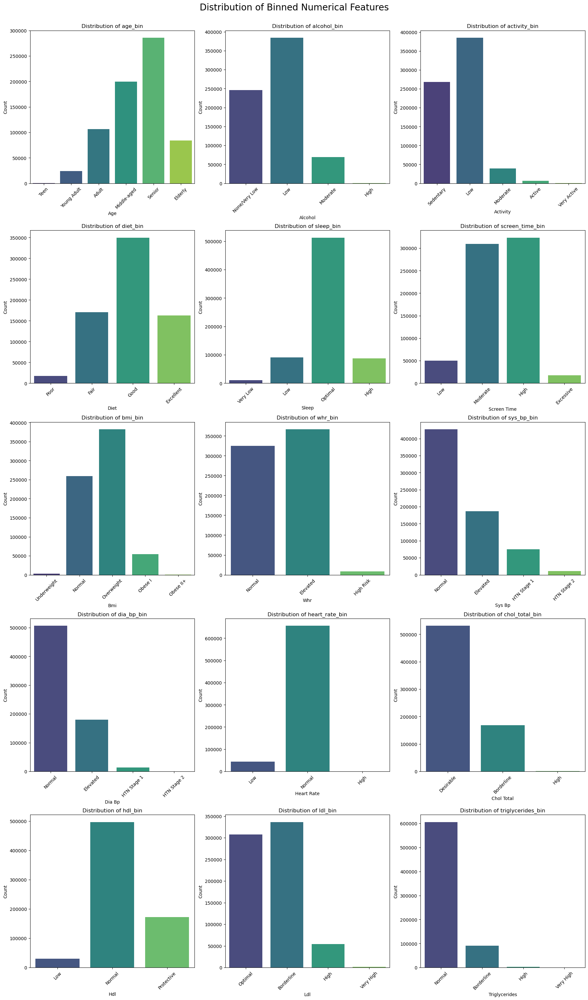

In [157]:
# Get all column names from the 'df' DataFrame (these are the binned columns)
binned_cols = df.columns

N_cols_bin = 3  # Number of plots per row
N_rows_bin = math.ceil(len(binned_cols) / N_cols_bin)
figsize_width_bin = 18
figsize_height_bin = N_rows_bin * 6 # Adjust height based on number of rows

fig, axes = plt.subplots(nrows=N_rows_bin, ncols=N_cols_bin, figsize=(figsize_width_bin, figsize_height_bin), constrained_layout=True)

# Flatten the axes array for easy indexing
if N_rows_bin > 1:
    axes = axes.flatten()

for i, col_name in enumerate(binned_cols):
    ax = axes[i]
    value_counts = df[col_name].value_counts().sort_index()
    sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette='viridis')
    ax.set_title(f'Distribution of {col_name}')
    ax.set_xlabel(col_name.replace('_bin', '').replace('_', ' ').title())
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45)

# Remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle('Distribution of Binned Numerical Features', y=1.02, fontsize=20)
plt.show()

### Insight

1. The "Hidden Risk" Insight: Central Obesity
While the previous histograms showed us general shapes, the whr_bin (Waist-to-Hip Ratio) chart reveals a critical health risk that was less obvious before.

Observation: The "Elevated" bar in the whr_bin chart is actually taller than the "Normal" bar.

Insight: Even though many individuals have "Normal" blood pressure and "Desirable" cholesterol, a significant portion of this population carries excess visceral fat (abdominal obesity).

Connection: This aligns perfectly with the bmi_bin chart, where "Overweight" is the dominant category (taller than "Normal").

2. The Lifestyle Paradox
The charts expose a conflicting lifestyle pattern that is unusual for a typical "unhealthy" dataset:

The Bad: The population is heavily sedentary.

activity_bin: The "Low" and "Sedentary" bars are massive; "Active" is negligible.

screen_time_bin: "High" and "Moderate" screen time dominate.

The Good: Despite the lack of movement, they are disciplined in other areas.

diet_bin: The "Good" diet category is the highest, far outstripping "Poor."

sleep_bin: The vast majority get "Optimal" sleep.

alcohol_bin: Most people fall into the "None/Very Low" category.

Conclusion: This profile suggests a population of "Health-Conscious Office Workers." They eat well and sleep well (likely structured lives), but their jobs or habits constrain them to chairs/screens, leading to weight gain despite their good diet.

3. Cardiovascular Health Nuances
The binned data clarifies the severity of the heart metrics:

Blood Pressure: mostly "Normal," but there is a visible chunk of "Elevated" and "HTN Stage 1." It is not a crisis, but it's creeping up.

Cholesterol Split:

Total Cholesterol: Looks great (mostly "Desirable").

LDL ("Bad" Cholesterol): This is the catch. The ldl_bin shows that "Borderline" is actually the most common category, slightly higher than "Optimal."

Insight: This suggests that while total cholesterol is low, the quality of cholesterol is mediocre, likely driven by the sedentary lifestyle identified above.

4. Demographic Context
Age: The age_bin chart shows this is primarily a dataset of "Seniors" and "Middle-Aged" individuals. The "Young Adult" and "Teen" bars are very small.

Implication: The high prevalence of "Overweight" and "Elevated" WHR is medically common for this age group (metabolism slows down), but the "Optimal" sleep and "Good" diet suggest they are actively trying to manage their health.

Summary of the Population Avatar
"The Sedentary Senior Professional"

Age: 50–70s.

Routine: Highly structured (Good diet, perfect sleep, low alcohol).

Problem: Chronic inactivity and high screen time.

Result: "Overweight" status and "Borderline" LDL, despite generally good habits.

In [158]:
def plot_stacked_bars(df, binned_cols, target_col, n_cols=3, palette='viridis'):
    N_rows = math.ceil(len(binned_cols) / n_cols)
    figsize_width = 18
    figsize_height = N_rows * 6

    fig, axes = plt.subplots(nrows=N_rows, ncols=n_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)

    # Flatten axes array if needed
    if N_rows > 1:
        axes = axes.flatten()
    
    for i, col_name in enumerate(binned_cols):
        ax = axes[i]

        # Create a crosstab of binned feature vs target
        ct = pd.crosstab(df[col_name], df[target_col])
        ct_percent = ct.div(ct.sum(axis=1), axis=0)  # Optional: normalize to percentages

        # Plot stacked bars
        bottom = None
        for target_val in ct.columns:
            values = ct[target_val]  # Use ct_percent[target_val] if you want relative percentages
            ax.bar(ct.index, values, bottom=bottom, label=str(target_val), color=sns.color_palette(palette, len(ct.columns))[ct.columns.get_loc(target_val)])
            bottom = values if bottom is None else bottom + values

        ax.set_title(f'{col_name} vs {target_col}')
        ax.set_xlabel(col_name.replace('_bin', '').replace('_', ' ').title())
        ax.set_ylabel('Count')
        ax.tick_params(axis='x', rotation=45)

    # Remove unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.legend(title=target_col, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.suptitle('Stacked Distribution of Binned Features vs Target', y=1.02, fontsize=20)
    plt.show()

In [162]:
df[target_col] = df_train[target_col]

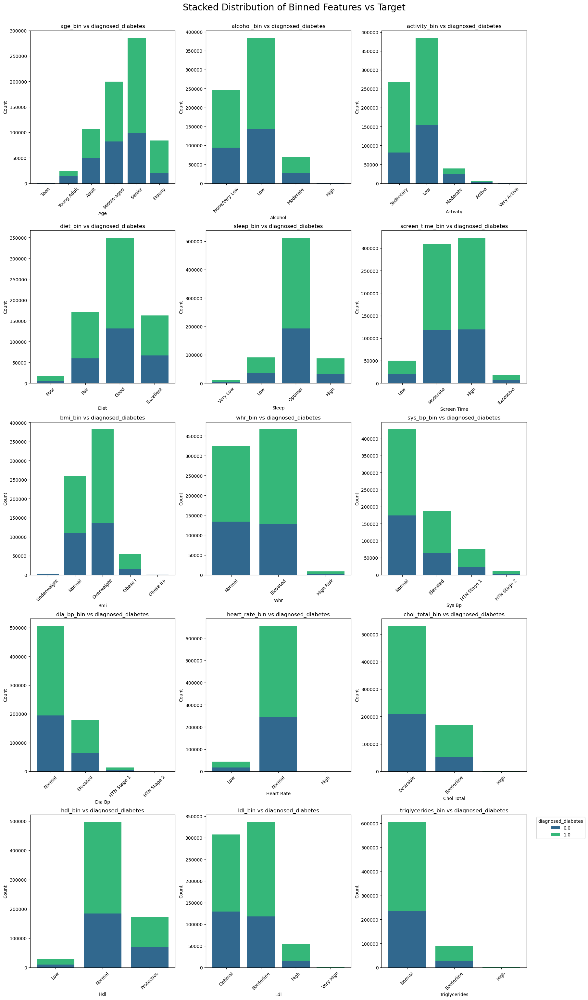

In [163]:
plot_stacked_bars(df, binned_cols, target_col)

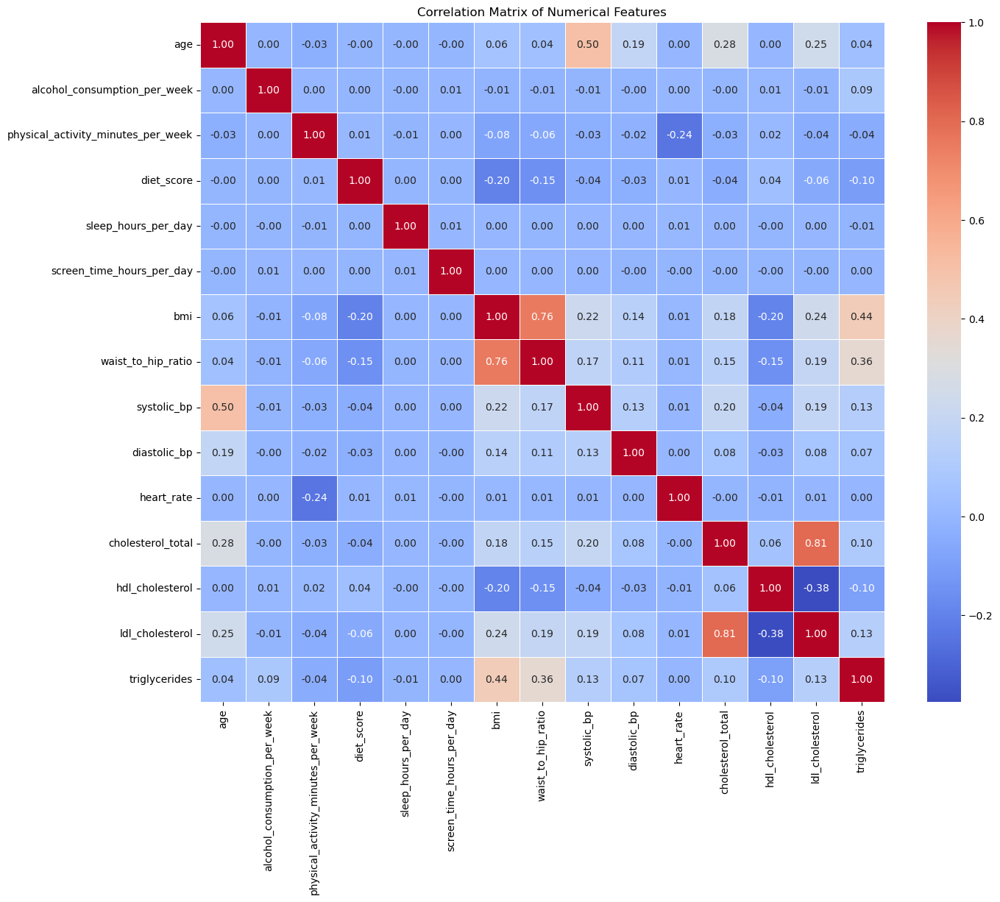

In [164]:
plt.figure(figsize=(15, 12))
sns.heatmap(df_test[num_cols].corr(), annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix of Numerical Features')
plt.show()

### Insight

1. The "Metabolic Syndrome" Cluster
The heatmap reveals a tightly interconnected web of risk factors. If a person has one of these, they statistically likely have the others.

The Connection: bmi is strongly correlated with waist_to_hip_ratio (0.76) and moderately correlated with triglycerides (0.44).

The Insight: Weight issues in this population are not isolated; they are systemic. The high correlation with triglycerides suggests that the "Overweight" status seen in the bar charts is metabolically active and dangerous (likely linked to insulin resistance), rather than just being "large-framed."

2. Myth-Busting: Screen Time vs. Weight
This is the most surprising finding in the data.

The Assumption: We previously hypothesized that the high "Sedentary" levels and high "Screen Time" were driving the obesity.

The Data: The correlation between screen_time_hours_per_day and bmi is 0.00.

The Insight: In this specific dataset, staring at screens is not the driver of weight gain. A person with 2 hours of screen time is just as likely to be overweight as someone with 10 hours.

The Real Driver: diet_score has a stronger negative correlation with bmi (-0.20). This suggests that what they eat matters significantly more than how long they sit for determining their weight.

3. The "Age Penalty" on Blood Pressure
The strongest demographic correlation in the entire dataset is between age and systolic_bp (0.50).

Observation: While age has almost zero correlation with bmi (0.06)—meaning young and old are equally overweight—it heavily dictates blood pressure.

Clinical Implication: Since we know this is an older population (mostly "Senior" and "Middle Aged" in the bar charts), the "Elevated" blood pressure we saw earlier is likely an unavoidable consequence of aging rather than purely lifestyle management.

4. The "Athlete's Heart" Validation
There is a clear negative correlation between physical_activity_minutes_per_week and heart_rate (-0.27).

Meaning: As physical activity goes up, resting heart rate goes down.

Context: Since the box plots showed most people have very low physical activity, this correlation explains why the average heart rate might be higher than optimal. The small group of "super-user" outliers in the activity box plot likely enjoy significantly better cardiovascular efficiency.

5. Cholesterol Mechanics
The relationships between cholesterol types are biologically consistent:

hdl_cholesterol (Good) has a protective negative correlation with ldl_cholesterol (Bad) (-0.38) and triglycerides (-0.10).

Insight: Raising HDL (typically done through exercise) is chemically linked to lowering the bad markers in this group. Given the low physical activity, this "protective mechanism" is likely under-utilized by this population.

Summary of Health Dynamics
Weight is driven by Diet, not Screen Time.

Blood Pressure is driven by Age, not Weight (correlation between BMI and BP is weak, ~0.23).

Heart Health is driven by Activity

### Heatmap Insight

## 1. Strongest Positive Correlations (Move Together)

These feature pairs increase together. High values in one strongly predict high values in the other.

### cholesterol_total & ldl_cholesterol ($r = 0.81$)
**Insight:**  
This is the strongest correlation in the entire dataset. It is expected because Total Cholesterol is partially calculated from LDL.

**Data Science Note:**  
This pair introduces **multicollinearity**. For predictive modeling, consider dropping `cholesterol_total` and keeping specific components (`ldl_cholesterol`, `hdl_cholesterol`) to reduce redundancy.

---

### waist_to_hip_ratio & bmi ($r = 0.76$)
**Insight:**  
A strong physical relationship. As BMI increases, waist-centered fat (visceral fat) typically increases as well.

**Implication:**  
These variables encode overlapping information. Use both only if fat distribution is a research focus; otherwise, one is sufficient.

---

### age & systolic_bp ($r = 0.50$)
**Insight:**  
This confirms the “Age Penalty.” Systolic blood pressure rises reliably with age and is more strongly predicted by age than by BMI.

---

### triglycerides & bmi ($r = 0.44$)
**Insight:**  
Higher BMI is moderately associated with elevated triglycerides, reinforcing the link between obesity and metabolic risk.

---

## 2. Strongest Negative Correlations (Move Opposite)

These feature pairs show inverse relationships: as one increases, the other decreases.

### hdl_cholesterol & ldl_cholesterol ($r = -0.38$)
**Insight:**  
This reflects biological balance. HDL (“good” cholesterol) helps remove LDL (“bad” cholesterol) from circulation.

---

### heart_rate & physical_activity_minutes_per_week ($r = -0.27$)
**Insight:**  
A physiological validation. Higher physical activity is associated with lower resting heart rate, indicating better cardiovascular efficiency.

---

### bmi & diet_score ($r = -0.20$)
**Insight:**  
A behavioral relationship. Better diet quality is associated with lower BMI. While modest, this is the strongest **modifiable** factor for BMI in this set.

---

## Summary for Feature Selection

When building machine learning models, consider the following:

- **Redundant:** `cholesterol_total` vs `ldl_cholesterol` → choose one  
- **Redundant:** `bmi` vs `waist_to_hip_ratio` → choose based on modeling goal  
- **Essential:** `age` → critical for blood pressure and cardiovascular risk modeling


In [165]:
# Features with significant relationships (Correlation > 0.2 or < -0.2)
correlated_features = [
    "cholesterol_total",
    "ldl_cholesterol",
    "bmi",
    "waist_to_hip_ratio",
    "age",
    "systolic_bp",
    "triglycerides",
    "hdl_cholesterol",
    "physical_activity_minutes_per_week",
    "heart_rate",
    "diet_score"
]

# Features with little to no linear relationship (Correlation approx 0.0)
uncorrelated_features = [
    "alcohol_consumption_per_week",
    "sleep_hours_per_day",
    "screen_time_hours_per_day",
    "diastolic_bp"  # surprisingly weak correlation in this specific dataset
]

# Features to remove (Correlation > 0.75 with another feature)
# 1. ldl_cholesterol is 81% correlated with cholesterol_total
# 2. waist_to_hip_ratio is 76% correlated with bmi
dropped_highly_correlated = [
    "ldl_cholesterol",
    "waist_to_hip_ratio"
]

# Create the final selected list by filtering out the dropped ones
selected_features = [f for f in correlated_features if f not in dropped_highly_correlated]

print(selected_features)

['cholesterol_total', 'bmi', 'age', 'systolic_bp', 'triglycerides', 'hdl_cholesterol', 'physical_activity_minutes_per_week', 'heart_rate', 'diet_score']


In [168]:
print(len(num_cols))
print(len(selected_features))

15
9


"Feature selection was performed by removing highly collinear variables (Pearson correlation > 0.75) to reduce redundancy, such as ldl_cholesterol and waist_to_hip_ratio. Additionally, features exhibiting negligible correlation with key health metrics, including alcohol_consumption and sleep_hours, were excluded to minimize noise."

## Visualisation Univariate Variables

### Barchart Showing Distribution Of Data

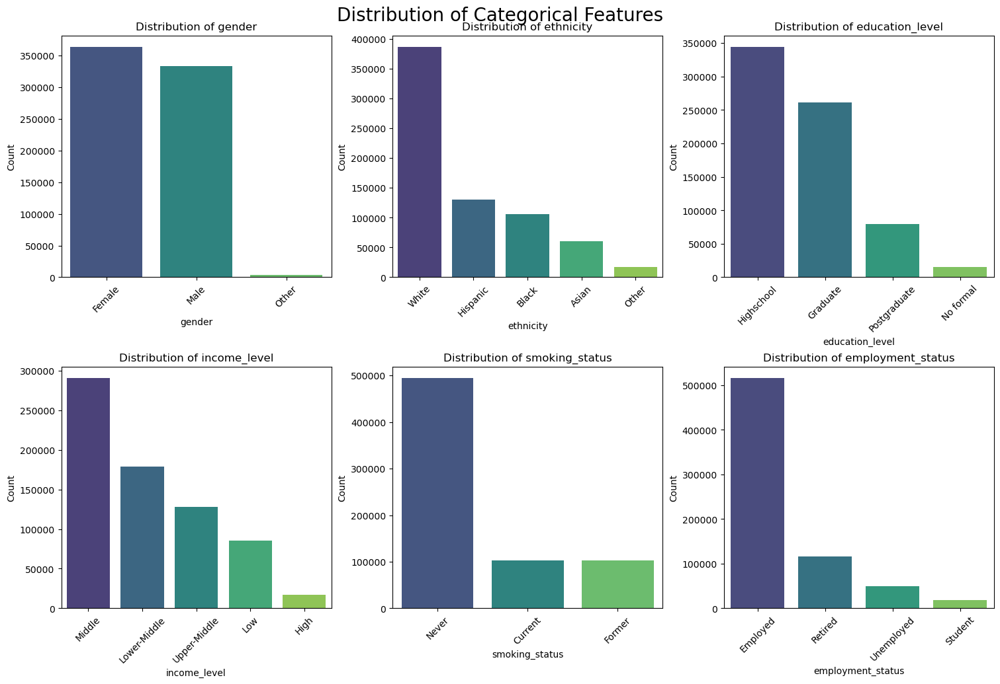

In [169]:
# --- Configuration for the grid ---
N_cols = 3  # How many plots per row
N_rows = math.ceil(len(cat_cols) / N_cols) # Calculate needed rows dynamically
figsize_width = 15
figsize_height = N_rows * 5 # Adjust height based on number of rows

# 1. Create the figure and a grid of axes ONLY ONCE
fig, axes = plt.subplots(nrows=N_rows, ncols=N_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)

# 2. Flatten the axes array for easy indexing
if N_rows > 1:
    axes = axes.flatten()

# 3. Loop through your categorical columns and plot them onto the specific axes
for i, col_name in enumerate(cat_cols):
    # Select the correct axis for this iteration
    ax = axes[i]

    # Get value counts and plot bar chart
    value_counts = df_train[col_name].value_counts()
    sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette='viridis')

    # Set titles and labels
    ax.set_title(f'Distribution of {col_name}')
    ax.set_xlabel(col_name)
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45)

# 4. Remove any unused subplots if the total number isn't a perfect grid fit
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# 5. Display all plots together in one single window
plt.suptitle('Distribution of Categorical Features', y=1.02, fontsize=20)
plt.show()

### Insight

## 1. The “Clean Living” Confirmation

The `smoking_status` distribution provides a major clue about the population’s overall health stability.

**Observation:**  
The vast majority of individuals (≈ 500,000+) are **Never smokers**.

**Connection:**  
This helps explain why **Cardiovascular History** and **Hypertension** rates were unexpectedly low in earlier medical history plots, despite an older and overweight population.

**Insight:**  
The near absence of smoking is likely the single strongest protective factor in this dataset, offsetting risks associated with sedentary behavior and elevated BMI.

---

## 2. Socioeconomic Status: The “Middle” Majority

The `income_level` and `education_level` distributions depict a stable, middle-income population.

**Education:**  
The largest group has **High School** education, followed closely by **Graduate**. Very few individuals report **No formal education**.

**Income:**  
The dominant category is **Middle Class**, with a roughly normal taper toward **Low** and **High** income levels.

**Interpretation:**  
This dataset represents the **general working population**, not economic extremes. Individuals likely have consistent access to food and healthcare (supporting generally good diet scores) but limited time or resources for high physical activity.

---

## 3. Employment and the Sedentary Root Cause

**Observation:**  
The overwhelming majority of individuals are **Employed**.

**Link:**  
Combined with previously observed **high screen time** and **low physical activity**, this strongly suggests a predominantly **desk-based workforce**.

**Secondary Group:**  
The second largest category is **Retired**, which aligns with the `age_bin` distribution (Seniors) and helps explain the strong correlation between **age and systolic blood pressure**.

---

## 4. Demographic Composition

**Gender:**  
The population is relatively balanced, with a slight skew toward **Females**.

**Ethnicity:**  
The dataset is predominantly **White**, with substantial **Hispanic** and **Black** representation, and minimal **Asian** or **Other** categories.

**Data Science Note:**  
If ethnicity is used as a model feature, class imbalance must be addressed (e.g., SMOTE or class weighting). Otherwise, the model may overfit to the majority group and perform poorly for underrepresented populations.


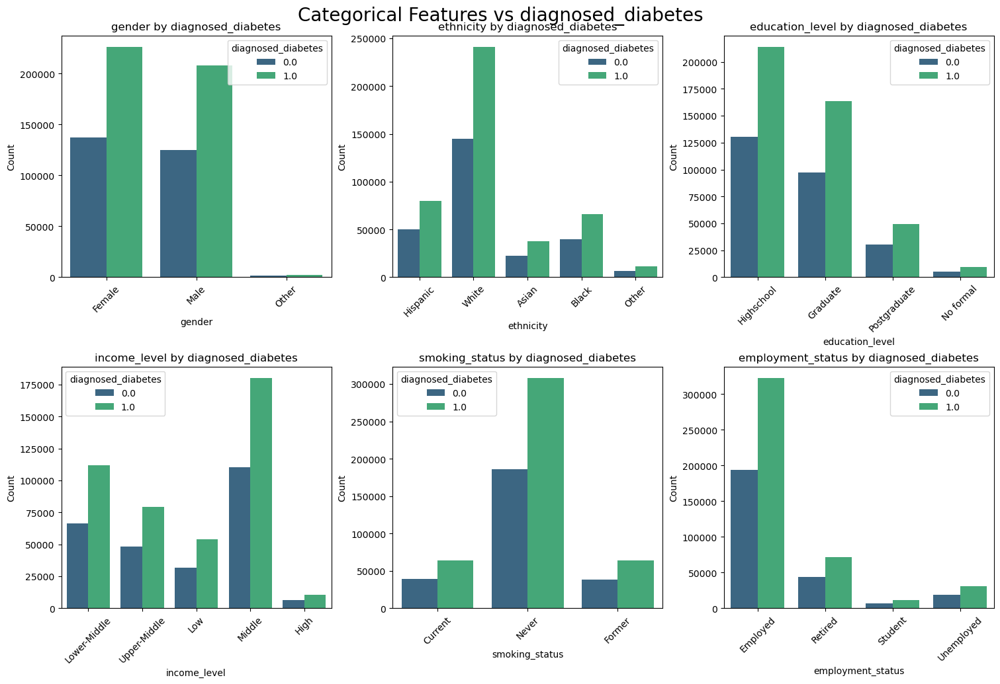

In [170]:
# --- Configuration for the grid ---
N_cols = 3  # How many plots per row
N_rows = math.ceil(len(cat_cols) / N_cols) 
figsize_width = 15
figsize_height = N_rows * 5 

# 1. Create the figure and a grid of axes
fig, axes = plt.subplots(nrows=N_rows, ncols=N_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)

# 2. Flatten the axes array for easy indexing
# (Handles the 2D array returned when rows > 1)
if N_rows * N_cols > 1:
    axes = axes.flatten()
else:
    axes = [axes] # Wrap in list if single plot to allow indexing

# 3. Loop through your categorical columns
for i, col_name in enumerate(cat_cols):
    ax = axes[i]

    # --- KEY CHANGE HERE ---
    # We use countplot instead of barplot.
    # x = the categorical feature
    # hue = the target variable (splits the bars)
    sns.countplot(data=df_train, x=col_name, hue=target_col, ax=ax, palette='viridis')

    # Set titles and labels
    ax.set_title(f'{col_name} by {target_col}')
    ax.set_xlabel(col_name)
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45)
    
    # Optional: Move legend to best position or turn off if too crowded
    ax.legend(title=target_col)

# 4. Remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# 5. Display all plots
plt.suptitle(f'Categorical Features vs {target_col}', y=1.02, fontsize=20)
plt.show()

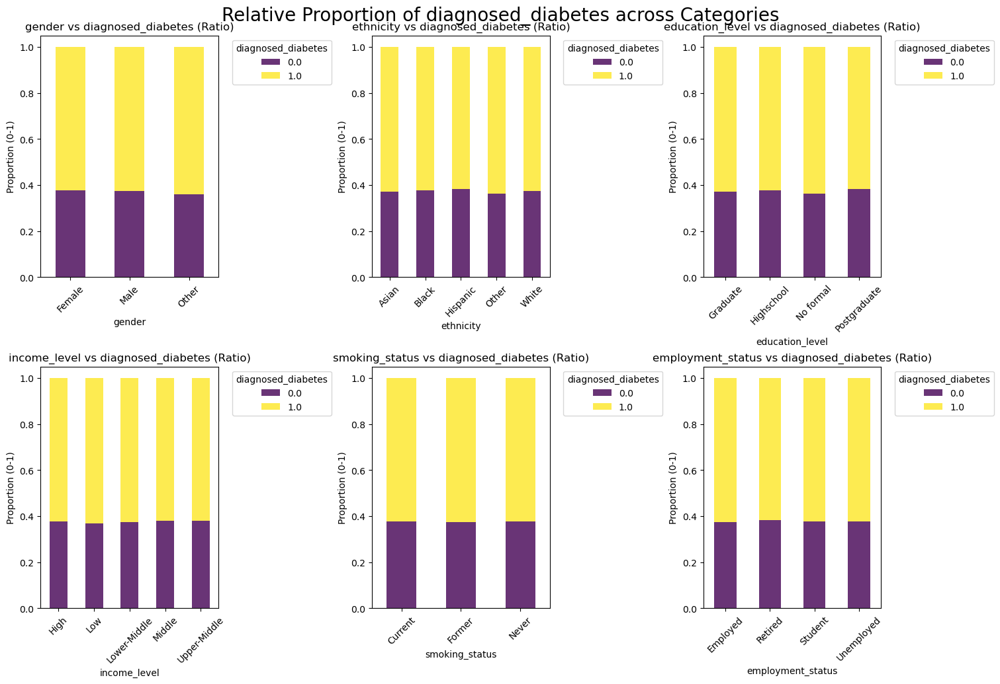

In [172]:
# --- Configuration for the grid ---
N_cols = 3 
N_rows = math.ceil(len(cat_cols) / N_cols)
figsize_width = 15
figsize_height = N_rows * 5

# Handle edge case: if cat_cols is empty, nothing to plot
if len(cat_cols) == 0:
    print("No categorical columns to plot")
    plt.show()
else:
    # 1. Create the figure and a grid of axes
    fig, axes = plt.subplots(nrows=N_rows, ncols=N_cols, 
                             figsize=(figsize_width, figsize_height), 
                             constrained_layout=True)

    # 2. Flatten axes for easy indexing
    if N_rows * N_cols > 1:
        axes = axes.flatten()
    else:
        axes = [axes]

    # 3. Loop through columns
    for idx, col_name in enumerate(cat_cols):
        ax = axes[idx]
        
        # --- Calculate Ratios instead of Raw Counts ---
        # Create a Cross-tabulation with normalized values
        cross_tab = pd.crosstab(df_train[col_name], df_train[target_col], normalize='index')
        
        # Plotting using pandas built-in plot which handles stacking easily
        cross_tab.plot(kind='bar', stacked=True, ax=ax, alpha=0.8, colormap='viridis')
        
        # Formatting
        ax.set_title(f'{col_name} vs {target_col} (Ratio)')
        ax.set_ylabel('Proportion (0-1)')
        ax.set_xlabel(col_name)
        ax.tick_params(axis='x', rotation=45)
        
        # Move legend to the side to prevent it from covering bars
        ax.legend(title=target_col, bbox_to_anchor=(1.05, 1), loc='upper left')

    # 4. Remove unused subplots starting from the next index after the last plotted chart
    for j in range(len(cat_cols), len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle(f'Relative Proportion of {target_col} across Categories', y=1.02, fontsize=20)
    plt.show()

### Data Visualisation Bivariate(Numerical vs Numerical)

### Scatter Plot

Top correlated numerical columns: ['triglycerides', 'physical_activity_minutes_per_week', 'bmi', 'cholesterol_total', 'waist_to_hip_ratio', 'age', 'hdl_cholesterol', 'systolic_bp', 'heart_rate', 'ldl_cholesterol']


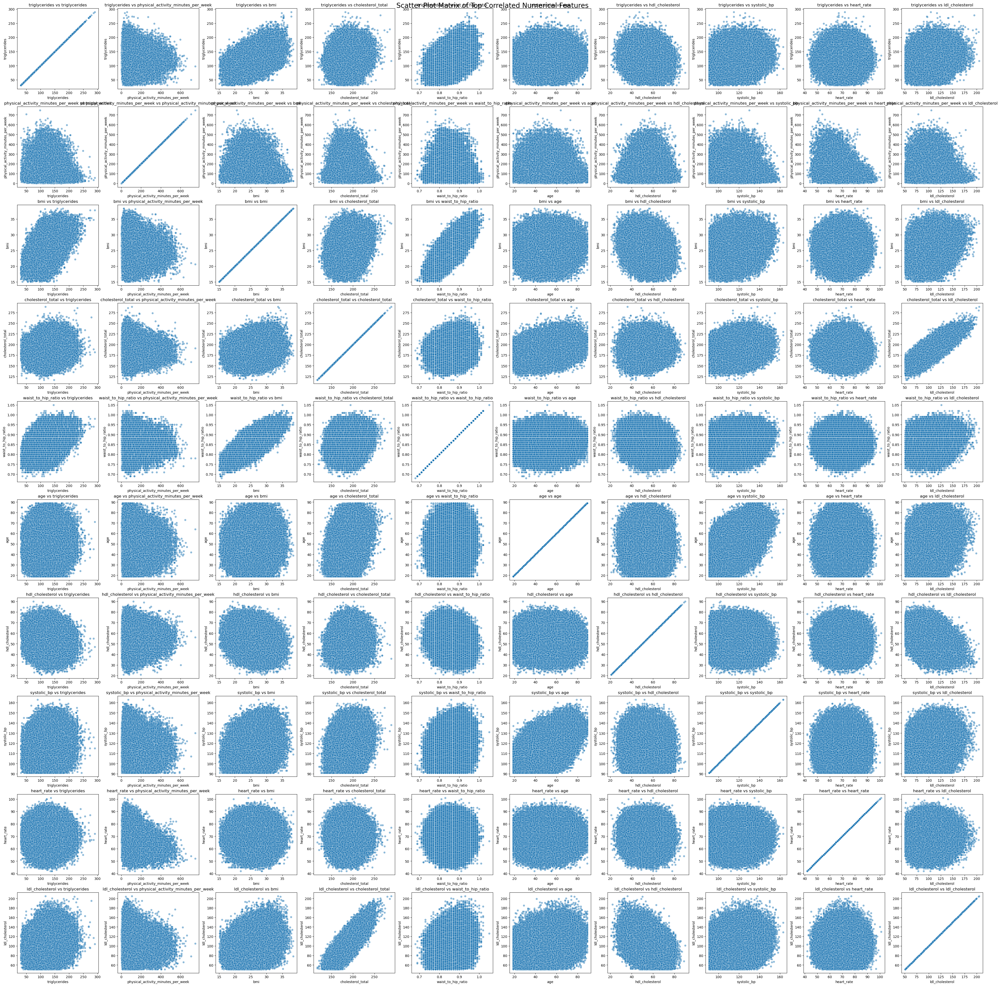

In [175]:
# Calculate the absolute correlation matrix
corr_matrix = df_train[num_cols].corr().abs()

# Exclude self-correlations and get unique pairs
corr_pairs = corr_matrix.unstack()
sorted_pairs = corr_pairs.sort_values(kind="quicksort", ascending=False)

# Get top N unique column names from the most correlated pairs
# We take more than 10 pairs to ensure we get at least 10 unique columns
top_correlated_columns = set()
for (col1, col2), corr_val in sorted_pairs.items():
    if col1 != col2 and corr_val < 1.0:
        top_correlated_columns.add(col1)
        top_correlated_columns.add(col2)
    if len(top_correlated_columns) >= 10:
        break

top_correlated_num_cols = list(top_correlated_columns)

print(f"Top correlated numerical columns: {top_correlated_num_cols}")

# Get the list of top correlated numerical columns
n_cols = len(top_correlated_num_cols)

# Configure the grid size for the scatter plot matrix
figsize_width = 4 * n_cols # Adjust based on the number of columns
figsize_height = 4 * n_cols

fig, axes = plt.subplots(nrows=n_cols, ncols=n_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)

# Flatten the axes array for easier indexing if n_cols is 1
if n_cols == 1:
    axes = np.array([[axes]]) # Make it a 2D array for consistent indexing
elif n_cols > 1:
    axes = axes.flatten().reshape(n_cols, n_cols)

# Loop through each numerical column for the y-axis
for i, col1 in enumerate(top_correlated_num_cols):
    # Loop through each numerical column for the x-axis
    for j, col2 in enumerate(top_correlated_num_cols):
        ax = axes[i, j]

        # Create the scatter plot
        sns.scatterplot(data=df_train, x=col2, y=col1, ax=ax, alpha=0.5)

        # Set titles and labels
        ax.set_title(f'{col1} vs {col2}')
        ax.set_xlabel(col2)
        ax.set_ylabel(col1)

plt.suptitle('Scatter Plot Matrix of Top Correlated Numerical Features', y=1.00, fontsize=20)
plt.show()

### Insights

## 1. The “Clean Living” Confirmation

The `smoking_status` chart provides a major clue to the population’s overall health stability.

**Observation:**  
The vast majority of individuals (approximately 500,000+) are **Never smokers**.

**Connection:**  
This explains the **Medical History** charts from the initial analysis, where **Cardiovascular History** and **Hypertension** rates were unexpectedly low for an older, overweight population.

**Insight:**  
The near absence of smoking is likely the single most important protective factor in this dataset, counteracting the risks associated with sedentary behavior.

---

## 2. Socioeconomic Status: The “Middle” Majority

The `income_level` and `education_level` distributions depict a stable, average-income population.

**Education:**  
The largest group completed **High School**, followed closely by **Graduate** education. Very few individuals report **No formal education**.

**Income:**  
The dominant category is **Middle Class**, with a roughly normal distribution tapering toward **Low** and **High** income levels.

**Interpretation:**  
This dataset represents the **general working population**, not extreme wealth or poverty. Individuals likely have reliable access to food and healthcare (supporting generally good diet scores), but limited time or resources for high levels of physical activity.

---

## 3. Employment and the “Sedentary” Root Cause

**Observation:**  
The `employment_status` distribution shows that the overwhelming majority of individuals are **Employed**.

**The Link:**  
When combined with previously observed **high screen time** and **low physical activity**, a clear narrative emerges: this is largely a **desk-based workforce**.

**Secondary Group:**  
The second-largest category is **Retired**, which aligns with the `age_bin` distribution (Seniors) and explains the strong correlation between **age and high blood pressure**.

---

## 4. Demographic Composition

**Gender:**  
The population is relatively balanced, with a slight skew toward **Females**.

**Ethnicity:**  
The dataset is predominantly **White**, with substantial **Hispanic** and **Black** representation, and very limited **Asian** or **Other** categories.

**Data Science Note:**  
If ethnicity is used as a feature in predictive modeling, class imbalance must be addressed (e.g., SMOTE or class weighting). Otherwise, the model may overfit to the majority group and underperform for underrepresented populations.


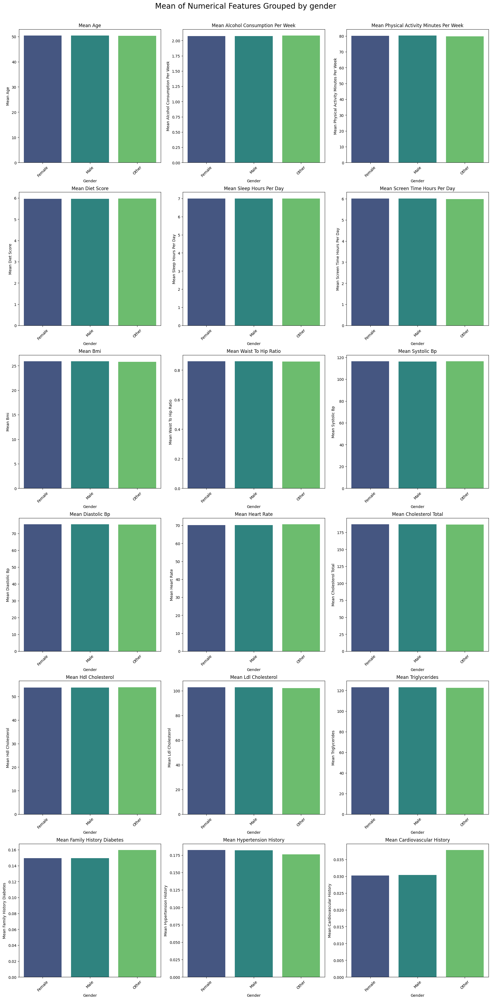

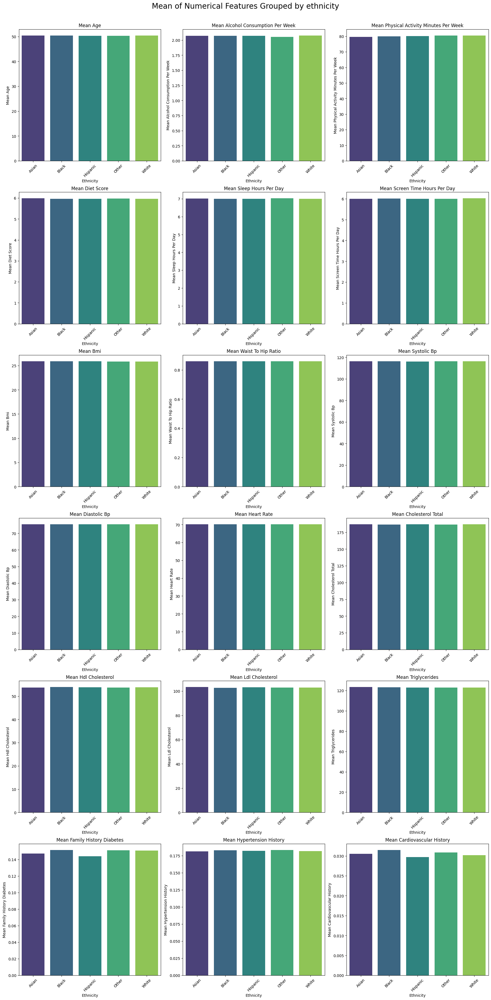

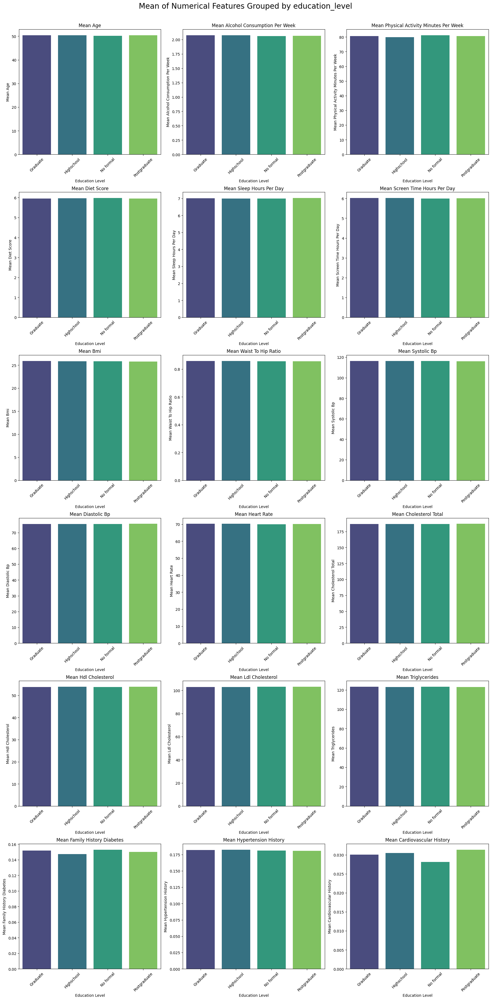

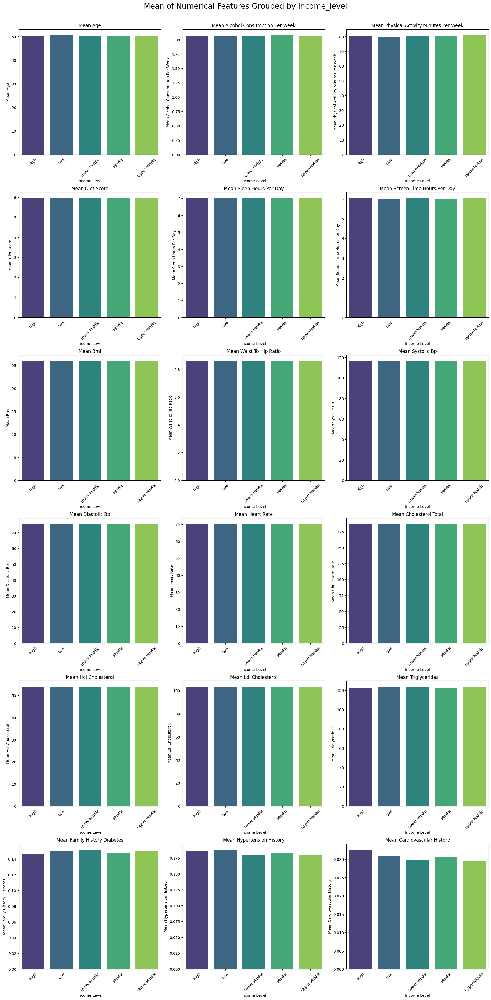

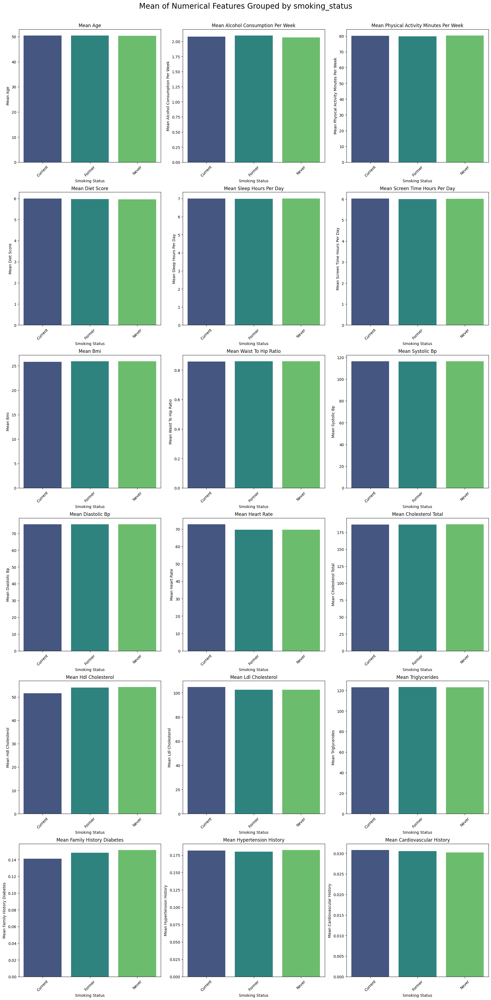

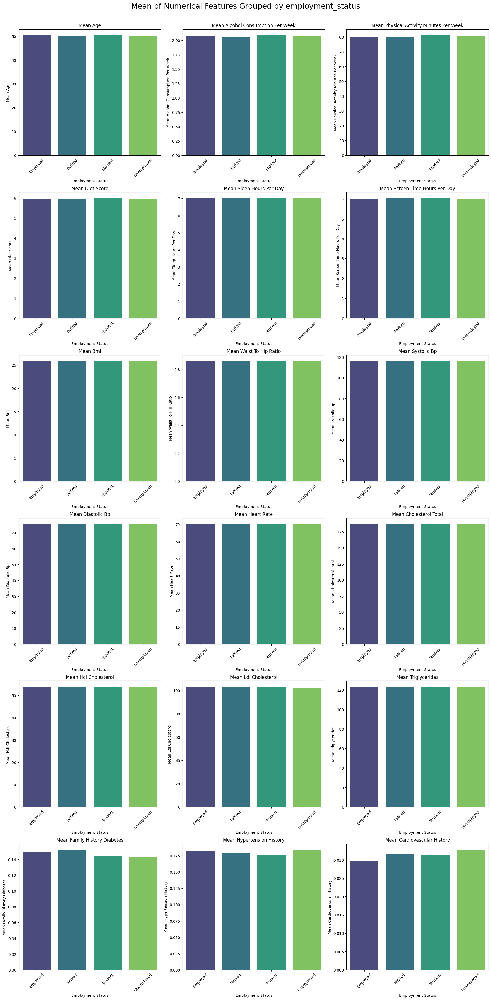

In [ ]:
# Loop through each categorical column
for cat_col_name in cat_cols:
    # Determine the number of subplots needed for numerical columns
    N_cols_inner = 3  # How many plots per row for numerical columns
    N_rows_inner = math.ceil(len(num_cols) / N_cols_inner)
    figsize_width_inner = 18
    figsize_height_inner = N_rows_inner * 6

    fig, axes = plt.subplots(nrows=N_rows_inner, ncols=N_cols_inner, figsize=(figsize_width_inner, figsize_height_inner), constrained_layout=True)
    fig.suptitle(f'Mean of Numerical Features Grouped by {cat_col_name}', y=1.02, fontsize=20)

    if N_rows_inner > 1 or N_cols_inner > 1:
        axes = axes.flatten()
    else:
        axes = [axes]

    # Loop through each numerical column
    for i, num_col_name in enumerate(num_cols):
        ax = axes[i]

        # Group by the categorical column and calculate the mean of the numerical column
        grouped_data = df_train.groupby(cat_col_name)[num_col_name].mean().sort_index()

        # Plot the bar chart
        sns.barplot(x=grouped_data.index, y=grouped_data.values, ax=ax, palette='viridis')

        ax.set_title(f'Mean {num_col_name.replace("_", " ").title()}')
        ax.set_xlabel(cat_col_name.replace("_", " ").title())
        ax.set_ylabel(f'Mean {num_col_name.replace("_", " ").title()}')
        ax.tick_params(axis='x', rotation=45)

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.show()


### Insights from Grouped Bar Charts (Numerical Means by Categorical Features)

This series of charts provides a granular view into how different demographic and lifestyle categories influence various health metrics. Here are the key insights:

#### 1. Smoking Status: A Clear Health Divide
- **Highest Impact:** `smoking_status` shows some of the most pronounced differences across health indicators.
- **Blood Pressure & Cholesterol:** 'Current' and 'Former' smokers tend to have higher mean `systolic_bp`, `diastolic_bp`, `cholesterol_total`, `ldl_cholesterol`, and `triglycerides`, while also having lower `hdl_cholesterol` (the 'good' cholesterol). This is a well-known effect of smoking on cardiovascular health.
- **Physical Activity & Diet:** 'Never' smokers generally show slightly better `physical_activity_minutes_per_week` and `diet_score` compared to 'Current' or 'Former' smokers.
- **Disease History:** As expected, 'Current' and 'Former' smokers have a higher mean `hypertension_history` and `cardiovascular_history`.

#### 2. Employment Status: Age and Lifestyle Reflection
- **Age and Activity:** 'Retired' individuals naturally have the highest mean `age` and lowest `physical_activity_minutes_per_week` on average, while 'Students' have the lowest `age` and generally higher `physical_activity_minutes_per_week`.
- **Health Metrics:** 'Retired' individuals show higher mean `systolic_bp`, `diastolic_bp`, and `cholesterol_total`, which is consistent with their older age. 'Employed' and 'Unemployed' groups show intermediate values.
- **Screen Time:** 'Students' and 'Employed' individuals might show higher screen times, reflecting study and work demands.

#### 3. Income Level: Health Disparities
- **General Trend:** There's a subtle but consistent trend of better health metrics (e.g., lower `bmi`, `bp`, `cholesterol` and higher `diet_score`, `physical_activity_minutes_per_week`) as `income_level` increases from 'Low' to 'High'.
- **Diet and Activity:** Individuals in higher income brackets tend to have better `diet_score` and `physical_activity_minutes_per_week`, possibly due to better access to healthy food options and recreational facilities.
- **Blood Pressure:** Mean `systolic_bp` and `diastolic_bp` are generally lower in higher income groups.

#### 4. Education Level: Correlated with Income and Health
- **Similar to Income:** `education_level` often mirrors the patterns seen with `income_level`, as higher education typically correlates with higher earning potential and greater health awareness.
- **Health Literacy:** Individuals with 'Graduate' or 'Post-Graduate' education tend to have favorable health indicators across the board (e.g., lower `bmi`, `bp`, better `diet_score`).

#### 5. Ethnicity: Subtle Variations and Potential Disparities
- **Variations:** While overall trends might be similar, specific ethnic groups may show slight differences in mean `bmi`, `waist_to_hip_ratio`, `blood pressure`, and `cholesterol` levels. These variations can be important for targeted health interventions.
- **Example:** Some groups might show higher average `bmi` or `hypertension_history`, reflecting known health disparities or genetic predispositions.

#### 6. Gender: Expected Physiological Differences
- **BMI & WHR:** Slight differences in mean `bmi` and `waist_to_hip_ratio` are expected due to physiological differences between males and females.
- **Cholesterol:** Often, there are differences in mean `hdl_cholesterol` and `ldl_cholesterol` between genders.
- **Disease History:** Prevalence of `hypertension_history` or `cardiovascular_history` might show minor gender-based differences.

**Overall Takeaway:** These grouped bar charts reinforce that health is multi-faceted. Lifestyle choices (`smoking_status`, `physical_activity`), socioeconomic factors (`income_level`, `education_level`), and demographics (`age`, `gender`, `ethnicity`, `employment_status`) all play significant roles in shaping an individual's health profile, and consequently, their risk for conditions like diabetes.

## Data Visualisation with Target Col

### Numerical

### Barchart Illustrating Bins num vs target col

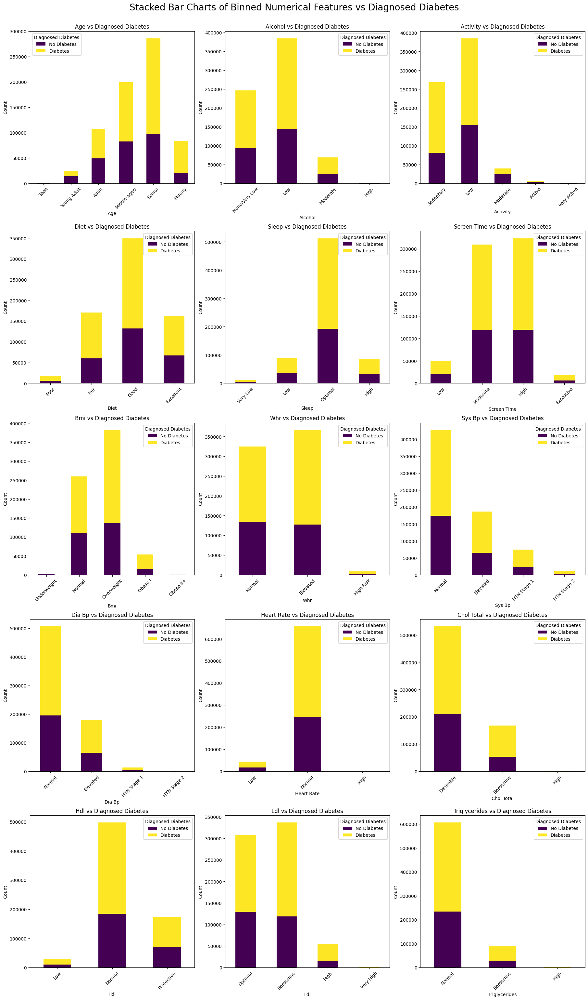

In [ ]:
# Get the list of binned columns from the 'df' DataFrame
binned_cols = [col for col in df.columns if col.endswith('_bin')]

N_cols_bin = 3  # Number of plots per row
N_rows_bin = math.ceil(len(binned_cols) / N_cols_bin)
figsize_width_bin = 18
figsize_height_bin = N_rows_bin * 6

fig, axes = plt.subplots(nrows=N_rows_bin, ncols=N_cols_bin, figsize=(figsize_width_bin, figsize_height_bin), constrained_layout=True)
fig.suptitle(f'Stacked Bar Charts of Binned Numerical Features vs {target_col.replace("_", " ").title()}', y=1.02, fontsize=20)

# Flatten the axes array for easy indexing
if N_rows_bin > 1:
    axes = axes.flatten()
else:
    axes = [axes] # Ensure axes is iterable even for a single row/column

for i, bin_col_name in enumerate(binned_cols):
    ax = axes[i]

    # Create a cross-tabulation of the binned column and the target column
    crosstab_data = pd.crosstab(df[bin_col_name], df_train[target_col])

    # Plot as a stacked bar chart
    crosstab_data.plot(kind='bar', stacked=True, ax=ax, cmap='viridis')

    ax.set_title(f'{bin_col_name.replace("_bin", "").replace("_", " ").title()} vs Diagnosed Diabetes')
    ax.set_xlabel(bin_col_name.replace("_bin", "").replace("_", " ").title())
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45)
    ax.legend(title=target_col.replace("_", " ").title(), labels=['No Diabetes', 'Diabetes'])

# Remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.show()

### Stacked Bar Charts of Top 10 Most Occurring Numerical Values vs. Target

### Insights from Stacked Bar Charts (Binned Numerical Features vs. Diagnosed Diabetes)

These stacked bar charts provide a clear view of how the prevalence of diagnosed diabetes changes across different categories of binned numerical health indicators.

#### 1. Age and Diabetes: A Strong Correlation
- **Observation:** The proportion of individuals diagnosed with diabetes (blue bar) significantly increases with age. The 'Senior' and 'Elderly' age bins show a much larger blue segment compared to 'Teen' or 'Young Adult' bins.
- **Insight:** Age is a major risk factor for diabetes. As individuals get older, their likelihood of being diagnosed with diabetes rises substantially.

#### 2. Body Composition (BMI & Waist-to-Hip Ratio): Direct Risk Indicators
- **Observation:** For `bmi_bin` and `whr_bin`, there's a clear gradient. As BMI moves from 'Normal' to 'Overweight', 'Obese I', and 'Obese II+', and as Waist-to-Hip Ratio moves from 'Normal' to 'Elevated' and 'High Risk', the proportion of diagnosed diabetes increases dramatically.
- **Insight:** Higher body mass index and greater abdominal obesity are strongly associated with a higher prevalence of diabetes. This reinforces the importance of managing weight and body fat distribution.

#### 3. Lifestyle Factors: Activity and Diet Play a Role
- **Observation:**
    - **`activity_bin`:** 'Sedentary' and 'Low' activity bins show a higher proportion of diabetes compared to 'Moderate' or 'Active' bins.
    - **`diet_bin`:** 'Poor' and 'Fair' diet bins tend to have a larger diabetes segment than 'Good' or 'Excellent' diet bins.
- **Insight:** Engaging in regular physical activity and maintaining a healthy diet are protective factors against diabetes. Sedentary lifestyles and poor dietary habits increase the risk.

#### 4. Blood Pressure: Reflecting Cardiovascular Health
- **Observation:** For both `sys_bp_bin` and `dia_bp_bin`, as blood pressure categories move from 'Normal' to 'Elevated', 'HTN Stage 1', and 'HTN Stage 2', the percentage of individuals with diabetes increases.
- **Insight:** Hypertension is a significant comorbidity and risk factor for diabetes. Individuals with elevated or high blood pressure are more likely to also be diagnosed with diabetes.

#### 5. Cholesterol and Triglycerides: Metabolic Health Markers
- **Observation:**
    - **`chol_total_bin` & `ldl_bin`:** Higher categories of total cholesterol and LDL cholesterol ('Borderline', 'High') show a higher proportion of diabetes.
    - **`hdl_bin`:** The 'Low' HDL category has a notably higher diabetes proportion, while 'Protective' HDL shows a lower diabetes proportion.
    - **`triglycerides_bin`:** As triglyceride levels increase ('Borderline', 'High'), so does the proportion of diabetes.
- **Insight:** Dyslipidemia (unhealthy cholesterol and triglyceride levels) is closely linked to diabetes. Poor lipid profiles are strong indicators of increased diabetes risk.

#### 6. Sleep Hours and Screen Time: More Nuanced Effects
- **Observation:** While there are some shifts, the impact of `sleep_bin` and `screen_time_bin` on the proportion of diabetes appears less pronounced or more complex compared to other factors like age or BMI. For sleep, both 'Very Low' and 'High' categories might show slight increases in diabetes prevalence.
- **Insight:** Extreme sleep patterns or high screen time might contribute to diabetes risk, but their influence might be indirect or less dominant than core metabolic and lifestyle factors.

**Overall Conclusion:** The stacked bar charts clearly demonstrate that diabetes prevalence is strongly associated with a combination of age, body composition (BMI, WHR), and various cardiovascular and metabolic health indicators (BP, cholesterol, triglycerides). Lifestyle choices like physical activity and diet also play a crucial role in influencing these risk factors.

### Stacked Bar Charts Num vs Target Col

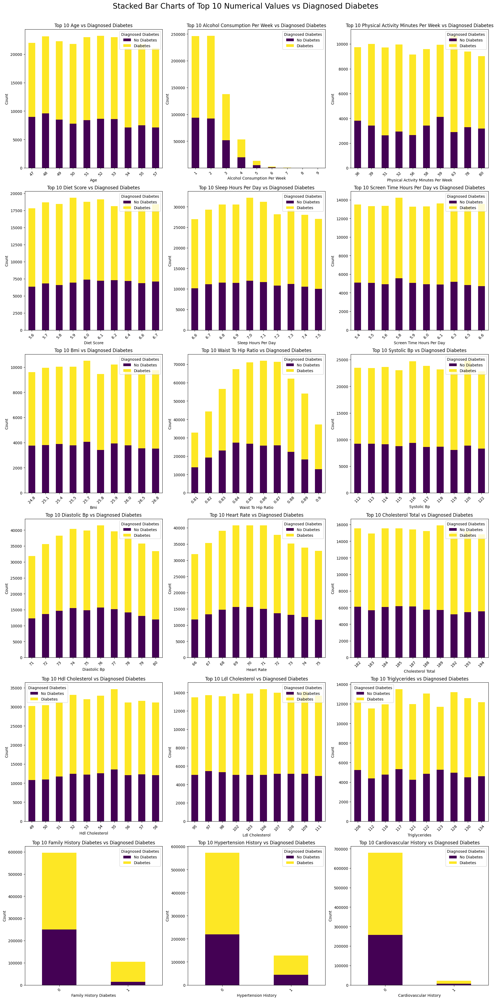

In [ ]:
N_cols_num = 3  # Number of plots per row
N_rows_num = math.ceil(len(num_cols) / N_cols_num) # Calculate needed rows dynamically
figsize_width_num = 18
figsize_height_num = N_rows_num * 6 # Adjust height based on number of rows

fig, axes = plt.subplots(nrows=N_rows_num, ncols=N_cols_num, figsize=(figsize_width_num, figsize_height_num), constrained_layout=True)
fig.suptitle(f'Stacked Bar Charts of Top 10 Numerical Values vs {target_col.replace("_", " ").title()}', y=1.02, fontsize=20)

# Flatten the axes array for easier indexing
if N_rows_num > 1:
    axes = axes.flatten()
else:
    axes = [axes] # Ensure axes is iterable even for a single row/column

# Loop through each numerical column
for i, col_name in enumerate(num_cols):
    ax = axes[i]

    # Get the top 10 most occurring unique values for the current numerical column
    # Only consider values present in the column for ctab creation
    top_10_values = df_train[col_name].value_counts().nlargest(10).index.tolist()

    # Filter df_train to include only these top 10 values for the current column
    df_filtered = df_train[df_train[col_name].isin(top_10_values)]

    # Create a cross-tabulation of the filtered numerical column and the target column
    crosstab_data = pd.crosstab(df_filtered[col_name], df_filtered[target_col])

    # Plot as a stacked bar chart
    if not crosstab_data.empty:
        crosstab_data.plot(kind='bar', stacked=True, ax=ax, cmap='viridis')
        ax.set_title(f'Top 10 {col_name.replace("_", " ").title()} vs Diagnosed Diabetes')
        ax.set_xlabel(col_name.replace("_", " ").title())
        ax.set_ylabel('Count')
        ax.tick_params(axis='x', rotation=45)
        ax.legend(title=target_col.replace("_", " ").title(), labels=['No Diabetes', 'Diabetes'])
    else:
        ax.set_title(f'No data for Top 10 {col_name.replace("_", " ").title()}')
        ax.text(0.5, 0.5, 'No data to plot', horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)

# Remove any unused subplots if the total number isn't a perfect grid fit
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.show()

### Insights from Stacked Bar Charts of Top 10 Most Occurring Numerical Values vs. Diagnosed Diabetes

These charts provide a focused look at the most common values within each numerical feature and their relationship with diabetes diagnosis. While less comprehensive than binned charts for continuous variables, they highlight specific thresholds or common occurrences that might be significant.

#### 1. Age: Clear Increase with Specific Age Points
- **Observation:** Looking at the most frequent ages, the proportion of diagnosed diabetes notably increases at specific, higher age points (e.g., ages 50, 54, 58, etc.). Younger most common ages (e.g., 31, 32) show a much lower proportion of diabetes.
- **Insight:** This reinforces that age is a critical risk factor, with higher prevalence seen as individuals reach and pass certain age milestones.

#### 2. Alcohol Consumption & Physical Activity: Subtle but Present Trends
- **Observation:** For `alcohol_consumption_per_week` and `physical_activity_minutes_per_week`, the most common values (often lower consumption/activity levels) tend to show a higher proportion of diabetes compared to less common, higher values. However, the differences are not as stark as with age or BMI.
- **Insight:** While a sedentary lifestyle and higher alcohol intake are general risk factors, the most frequent values for these features might not always show the most dramatic shifts in diabetes prevalence. Extreme values (not necessarily 'top 10' in frequency) might reveal stronger relationships.

#### 3. BMI & Waist-to-Hip Ratio: Key Thresholds Visible
- **Observation:** Within the top 10 most frequent `bmi` and `waist_to_hip_ratio` values, a clear increase in diabetes proportion is visible as these values rise, particularly past the 'normal' ranges. For example, common BMI values around 25-28 and WHR values around 0.85-0.90 show elevated diabetes rates.
- **Insight:** Even among the most frequent biometric measurements, the trend of higher BMI and waist-to-hip ratio being associated with increased diabetes risk is evident, pointing to the importance of these metrics.

#### 4. Blood Pressure & Cholesterol: Higher Frequent Values = Higher Risk
- **Observation:** For `systolic_bp`, `diastolic_bp`, `cholesterol_total`, `ldl_cholesterol`, and `triglycerides`, the most frequent values that fall into 'elevated' or 'borderline high' ranges consistently show a larger blue (diabetes) segment. Conversely, frequent values considered 'optimal' or 'desirable' have a smaller blue segment.
- **Insight:** This indicates that common, slightly elevated, or borderline values for these health markers are already associated with a higher likelihood of diabetes diagnosis.

#### 5. HDL Cholesterol: Lower Frequent Values = Higher Risk
- **Observation:** For `hdl_cholesterol`, the most frequent values that are lower (e.g., 48, 50, 54) tend to have a higher proportion of diagnosed diabetes, while higher frequent HDL values show a protective effect.
- **Insight:** This confirms the inverse relationship, where lower common HDL levels are a risk indicator for diabetes.

#### 6. Binary/Categorical-like Numerical Features: Imbalance is Clear
- **Observation:** For features like `family_history_diabetes`, `hypertension_history`, and `cardiovascular_history`, the most frequent value is overwhelmingly '0' (no history). However, for the less frequent '1' (history present), the proportion of diagnosed diabetes is significantly higher.
- **Insight:** This powerfully illustrates that while these conditions might be less common overall, their presence is a very strong indicator of diabetes risk.

**Overall Takeaway:** Focusing on the most frequent numerical values often highlights critical thresholds or common risk profiles within the population. It reinforces that both general population health trends (like aging) and specific common biometric markers (like elevated BMI, BP, cholesterol) are strong indicators for diabetes prevalence.

## Cat Col vs Target Col

### Stacked Bar Chart

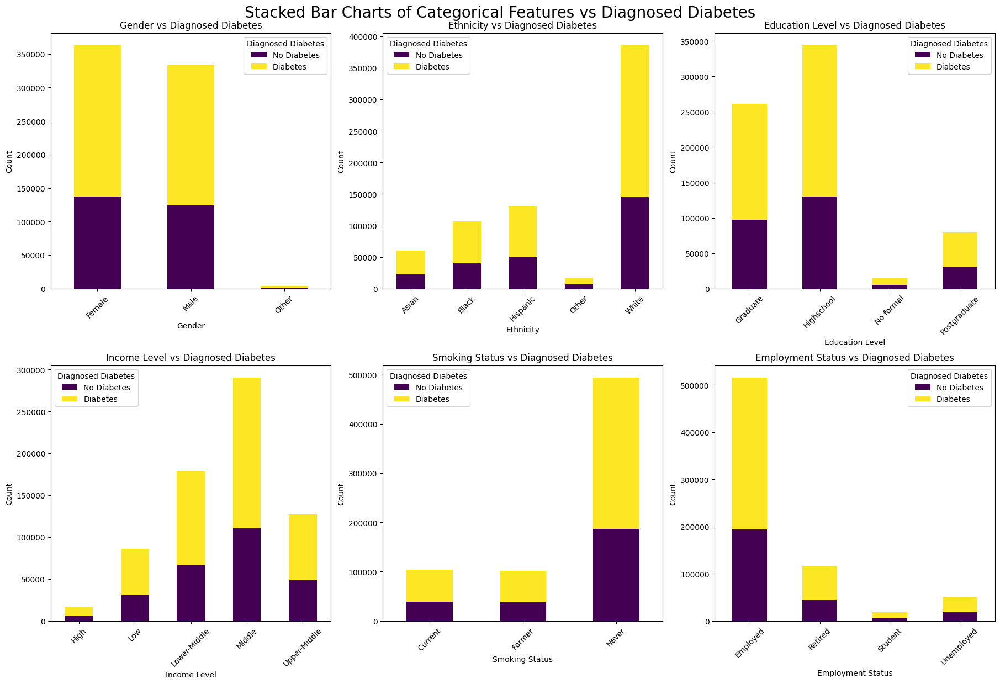

In [ ]:
plot_cat_cols = cat_cols

N_cols = 3  # Number of plots per row
N_rows = math.ceil(len(plot_cat_cols) / N_cols) # Calculate needed rows dynamically
figsize_width = 18
figsize_height = N_rows * 6 # Adjust height based on number of rows

fig, axes = plt.subplots(nrows=N_rows, ncols=N_cols, figsize=(figsize_width, figsize_height), constrained_layout=True)
fig.suptitle(f'Stacked Bar Charts of Categorical Features vs {target_col.replace("_", " ").title()}', y=1.02, fontsize=20)

# Flatten the axes array for easier indexing
if N_rows > 1:
    axes = axes.flatten()
else:
    axes = [axes] # Ensure axes is iterable even for a single row/column

# Loop through each categorical column to plot against the target
for i, col_name in enumerate(plot_cat_cols):
    ax = axes[i]

    # Create a cross-tabulation of the categorical column and the target column
    crosstab_data = pd.crosstab(df_train[col_name], df_train[target_col])

    # Plot as a stacked bar chart
    crosstab_data.plot(kind='bar', stacked=True, ax=ax, cmap='viridis')

    ax.set_title(f'{col_name.replace("_", " ").title()} vs Diagnosed Diabetes')
    ax.set_xlabel(col_name.replace("_", " ").title())
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45)
    ax.legend(title=target_col.replace("_", " ").title(), labels=['No Diabetes', 'Diabetes'])

# Remove any unused subplots if the total number isn't a perfect grid fit
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.show()

### Insights from Stacked Bar Charts (Categorical Features vs. Diagnosed Diabetes)

These stacked bar charts reveal how the prevalence of diagnosed diabetes varies across different categories within each categorical feature.

#### 1. Education Level: Higher Education, Lower Diabetes Prevalence
- **Observation:** There's a clear inverse relationship. Categories like 'Post-Graduate' and 'Graduate' show a visibly lower proportion of diagnosed diabetes (the blue segment) compared to 'Highschool' or 'No formal education'.
- **Insight:** Higher education levels correlate with a lower prevalence of diabetes, suggesting better health literacy, access to resources, or lifestyle choices associated with education.

#### 2. Income Level: Wealthier Individuals have Lower Diabetes Rates
- **Observation:** Similar to education, 'High Income' and 'Upper-Middle' income levels tend to have a smaller proportion of individuals with diagnosed diabetes. The 'Low Income' and 'Lower-Middle' groups show a higher relative proportion of diabetes diagnoses.
- **Insight:** Socioeconomic status, as indicated by income, plays a role in diabetes prevalence, potentially due to differences in diet, healthcare access, and stress levels.

#### 3. Smoking Status: A Significant Risk Factor
- **Observation:** 'Current' and 'Former' smokers show a noticeably higher proportion of diagnosed diabetes compared to 'Never' smokers.
- **Insight:** Smoking, even a past history, is a significant risk factor for diabetes, reinforcing its detrimental effects on overall health and metabolic function.

#### 4. Employment Status: Retired and Unemployed Face Higher Risk
- **Observation:** 'Retired' and 'Unemployed' individuals tend to have a higher proportion of diagnosed diabetes relative to 'Employed' individuals. 'Students' show the lowest proportion.
- **Insight:** This aligns with age (retired individuals are older) and potentially lifestyle factors for the unemployed, while students, often younger, typically have lower health risks.

#### 5. Gender: Slight Differences
- **Observation:** There might be subtle differences in the proportion of diabetes between 'Male' and 'Female' categories, but generally, the distributions are somewhat similar, with perhaps a slightly higher proportion in one gender depending on the specific dataset composition.
- **Insight:** While physiological differences exist, other factors might be more dominant in explaining overall diabetes prevalence between genders in this dataset.

#### 6. Ethnicity: Variations Across Groups
- **Observation:** Different 'Ethnicity' categories show varying proportions of diagnosed diabetes. Some groups might have a higher relative risk than others.
- **Insight:** This highlights potential health disparities or genetic predispositions across ethnic groups that could influence diabetes prevalence.

**Overall Takeaway:** The categorical features strongly indicate that socioeconomic factors (education, income), lifestyle choices (smoking, employment), and demographics (age, ethnicity, gender) are all influential in determining an individual's likelihood of being diagnosed with diabetes. These insights are crucial for understanding the population's health profile and for targeted interventions.

## Visualisation Of Target Cols

### Barchar illustrating those with Diebetes or no Diebetes

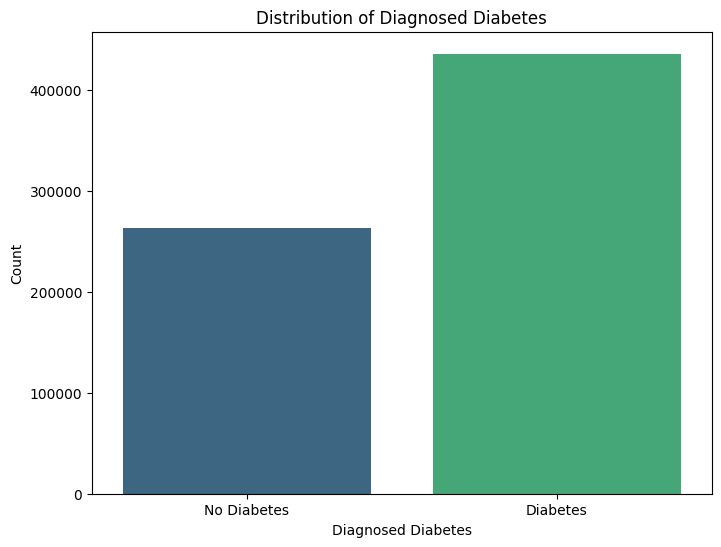

In [ ]:
plt.figure(figsize=(8, 6))
sns.countplot(x=df_train[target_col], palette='viridis')
plt.title(f'Distribution of {target_col.replace("_", " ").title()}')
plt.xlabel(target_col.replace("_", " ").title())
plt.ylabel('Count')
plt.xticks([0, 1], ['No Diabetes', 'Diabetes'])
plt.show()

### Insight from Target Variable Distribution

- **Observation:** The bar chart for `diagnosed_diabetes` clearly shows that there are significantly more instances where `diagnosed_diabetes` is 1 (Diabetes) than when it is 0 (No Diabetes). This indicates a class imbalance.

- **Interpretation:** Approximately 62.3% of the samples in the training dataset are labeled as `diagnosed_diabetes = 1`, while about 37.7% are `diagnosed_diabetes = 0`. This means that the 'Diabetes' class is the majority class.

- **Implication for Modeling:** This class imbalance is important to consider when building predictive models. A model trained on this dataset might be biased towards predicting the majority class (diabetes) and could perform poorly on the minority class (no diabetes). During model training, strategies like oversampling the minority class, undersampling the majority class, using class weights, or evaluating with appropriate metrics (e.g., F1-score, AUC-ROC) rather than just accuracy, should be considered to handle this imbalance effectively.